## IGO16235_IGO16562 - KP R26-mTmG; Slc4a11-MCD mice exposed to Saline, Cisplatin, MRTX1133
Combines lanes for Saline vs Cisplatin vs MRTX1133 experiment

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib as plt

from pathlib import Path
import anndata
from joblib import dump, load

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [4]:
results_file = 'write/IGO16235_16562.h5ad'  # the file that will store the analysis results

In [5]:
adata1 = anndata.read('../IGO16235/write/allmice-tumor-IGO16235.h5ad')
adata2 = anndata.read('../IGO16562/write/allmice-tumor-IGO16562.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [6]:
adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/2331359869.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])


## Set highly variable genes

In [7]:
sc.pp.highly_variable_genes(adata, batch_key='batch')

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


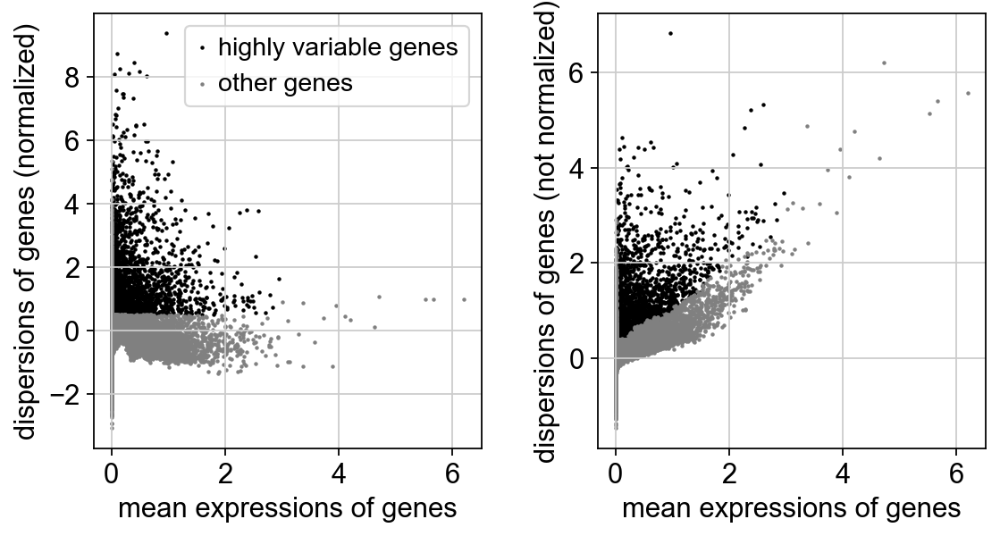

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/2373117142.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/237311

In [10]:
adata.raw = adata

In [11]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [12]:
adata.write('write/allmice-IGO16235_IGO16562_combined.h5ad', compression='gzip')

## Principal component analysis

In [13]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:03)


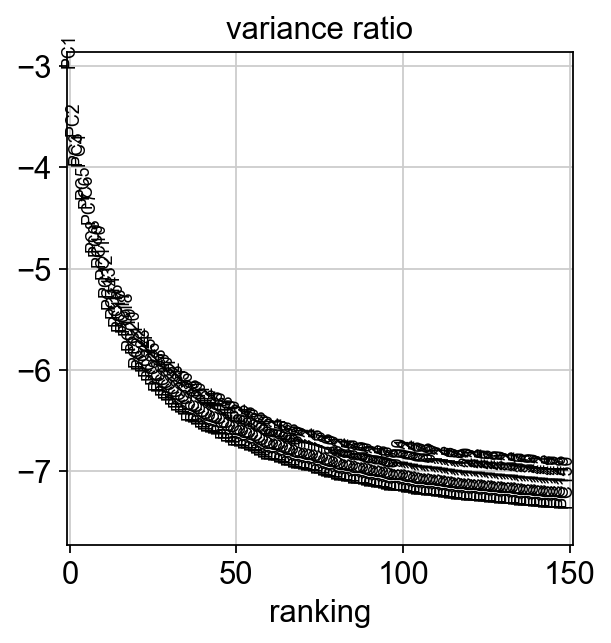

In [14]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

## Computing the neighborhood graph

In [15]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)


## Embedding the neighborhood graph

In [16]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:05)


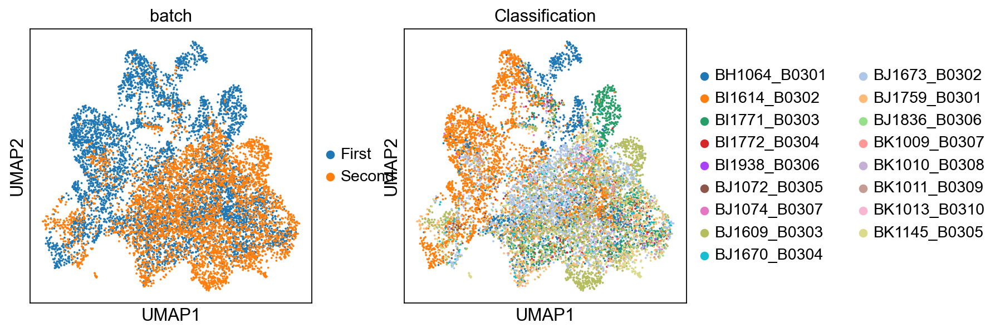

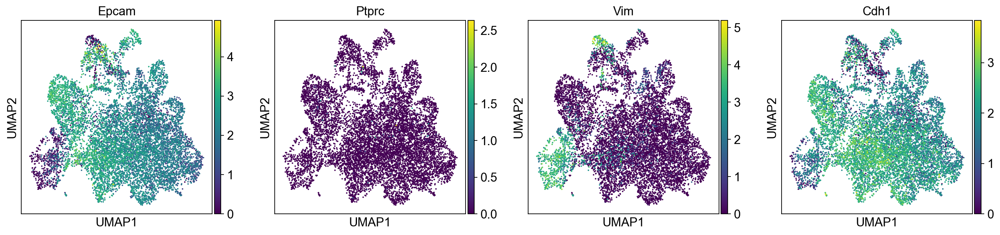

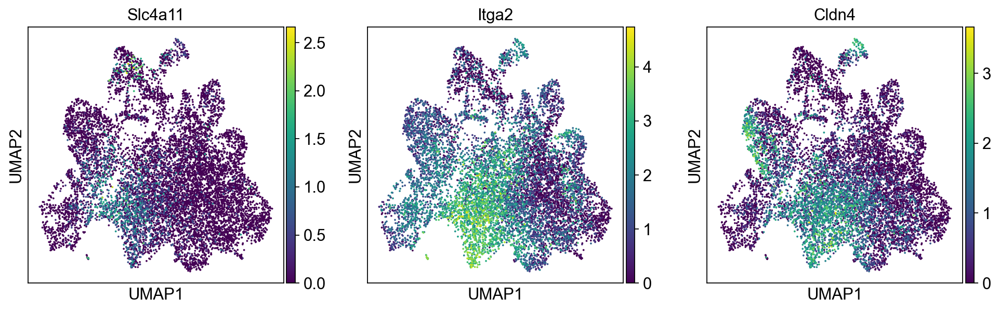

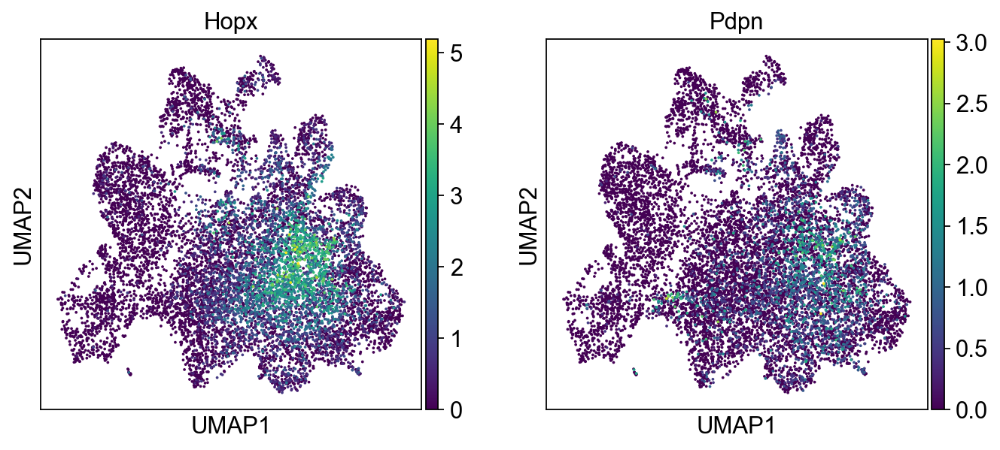

In [17]:
sc.pl.umap(adata, color=['batch','Classification',])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

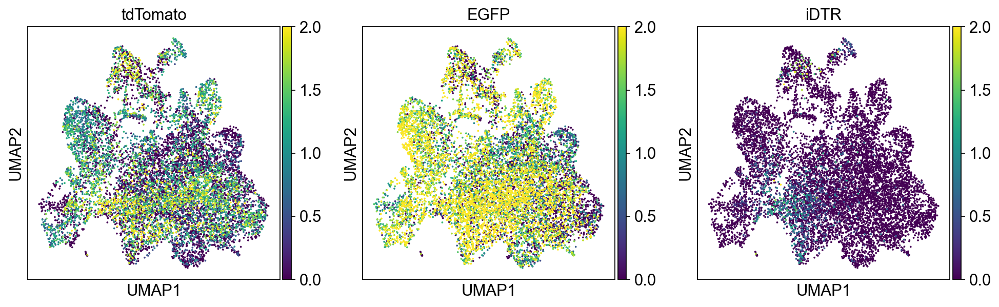

In [18]:
sc.pl.umap(adata, color=['tdTomato','EGFP','iDTR'], vmax=2) #,'mScarlet'

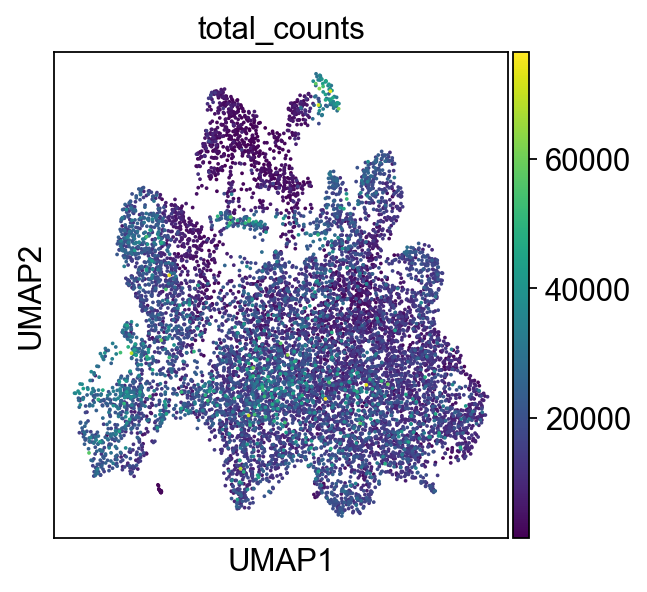

In [19]:
sc.pl.umap(adata, color=['total_counts'])

## Define scoring Functions

In [20]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [21]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [22]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1486 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1192 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1492 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1391 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1693 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps6', 'Fam46c', 'Gm6139'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1791 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', sco

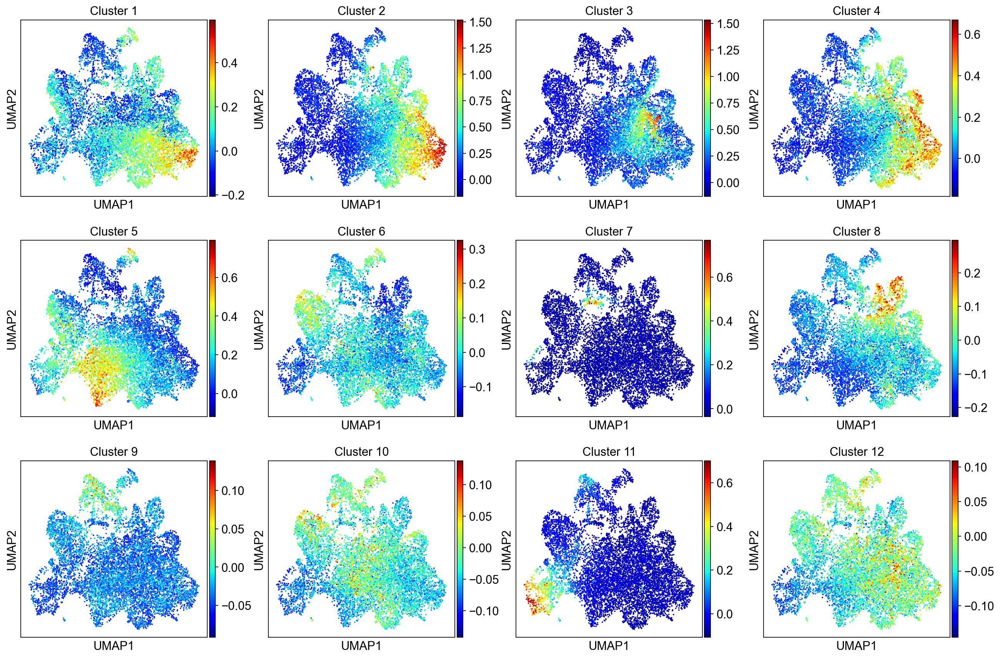

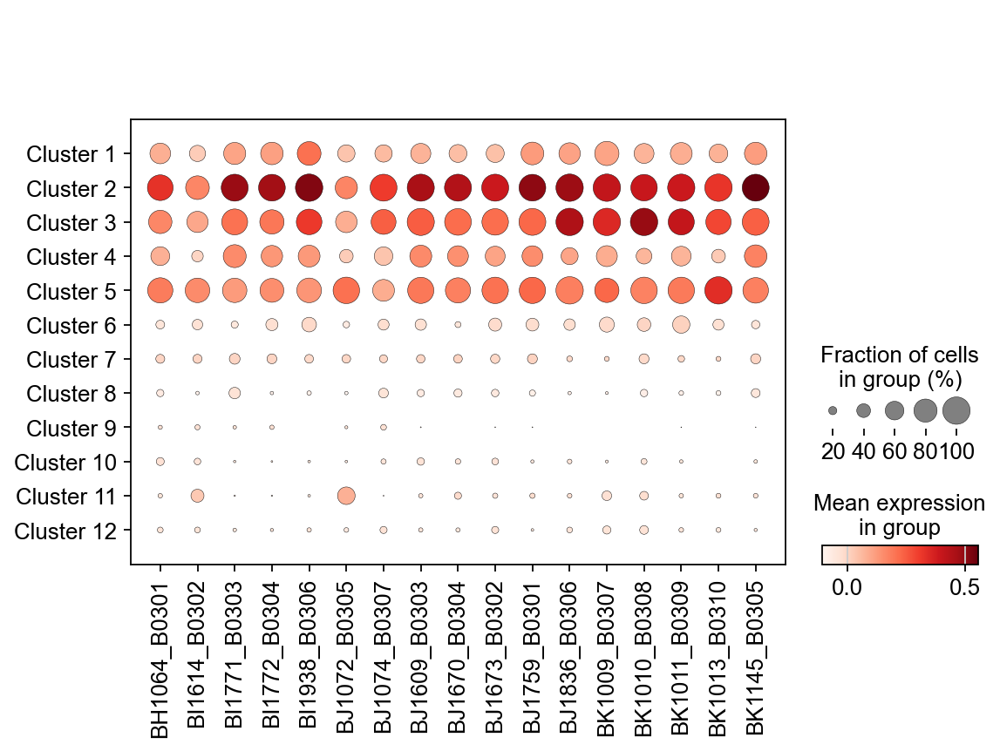

In [23]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

In [24]:
sc.tl.leiden(adata, resolution=0.4)

running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/3931443330.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.4)


    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


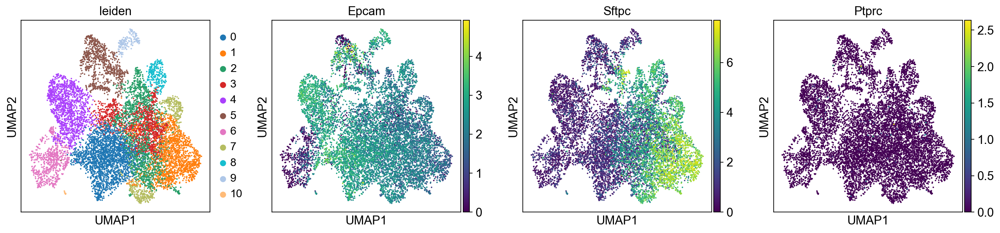

(None,)

In [25]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

In [26]:
adata.obs.Group.value_counts(sort=False)

Group
Cisplatin    3623
MRTX1133      409
Saline       6489
Name: count, dtype: int64

In [27]:
adata.obs['Group'] = adata.obs['Group'].cat.reorder_categories(['Saline','Cisplatin','MRTX1133'], ordered=True)

In [28]:
adata.obs.Group.value_counts(sort=False)

Group
Saline       6489
Cisplatin    3623
MRTX1133      409
Name: count, dtype: int64

In [29]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification
Saline     BH1064_B0301      1315
           BI1614_B0302      3206
           BJ1673_B0302      1546
           BJ1759_B0301       422
Cisplatin  BI1771_B0303      1059
           BI1772_B0304       160
           BJ1072_B0305        94
           BJ1609_B0303      1442
           BJ1670_B0304       205
           BK1145_B0305       663
MRTX1133   BI1938_B0306        23
           BJ1074_B0307       175
           BJ1836_B0306        32
           BK1009_B0307        20
           BK1010_B0308        23
           BK1011_B0309       126
           BK1013_B0310        10
Name: count, dtype: int64

In [30]:
sc.tl.embedding_density(adata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


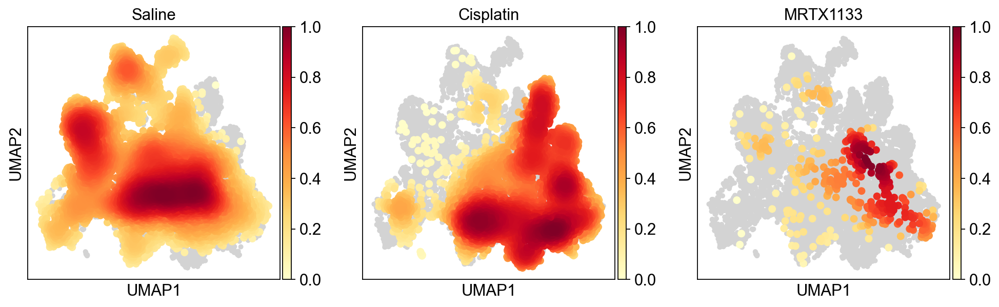

In [31]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group')

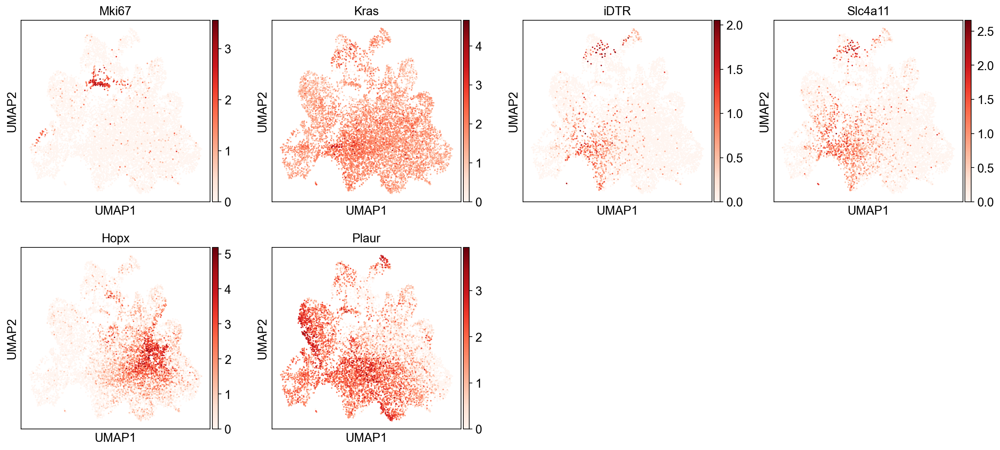

In [32]:
sc.pl.umap(adata, color=['Mki67', 'Kras','iDTR','Slc4a11','Hopx','Plaur'],cmap='Reds')

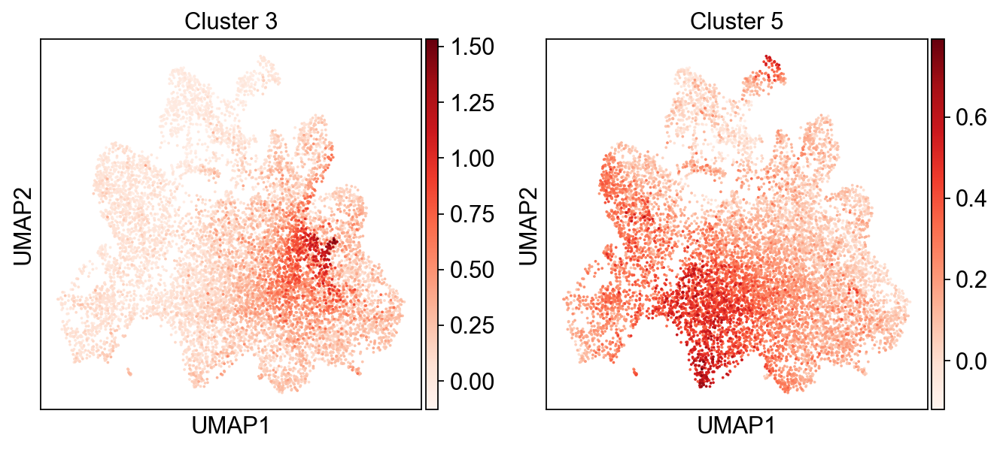

In [33]:
sc.pl.umap(adata, color=['Cluster 3','Cluster 5'], cmap='Reds')

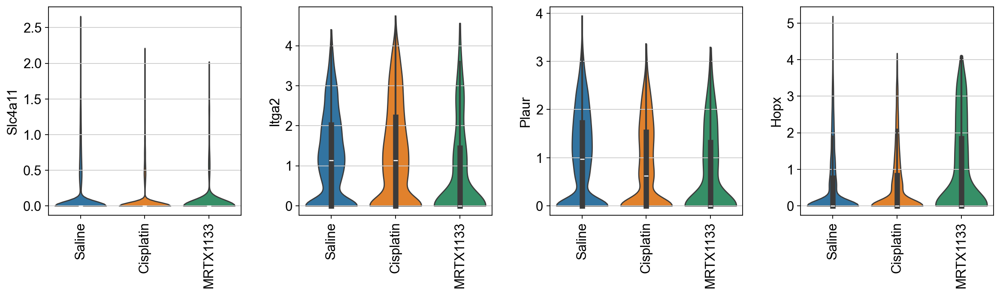

In [34]:
sc.pl.violin(adata, ['Slc4a11','Itga2','Plaur','Hopx',], 
             groupby='Group',rotation=90,inner='box',stripplot=False)

In [35]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


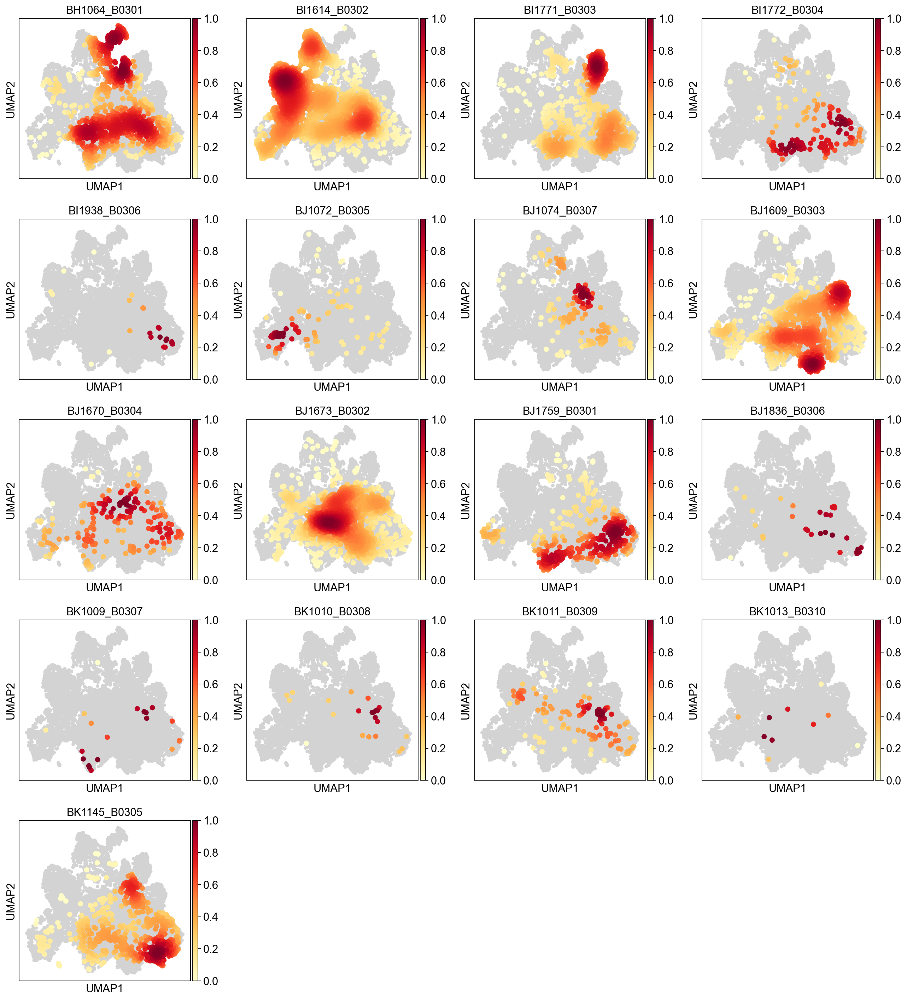

In [36]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

## Explore Phase

In [37]:
cell_cycle_genes = [x.strip() for x in open('../../common_files/regev_lab_cell_cycle_genes_mouse.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [38]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    599 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    515 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=35


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_pca/__init__.py:379: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


    finished (0:00:00)


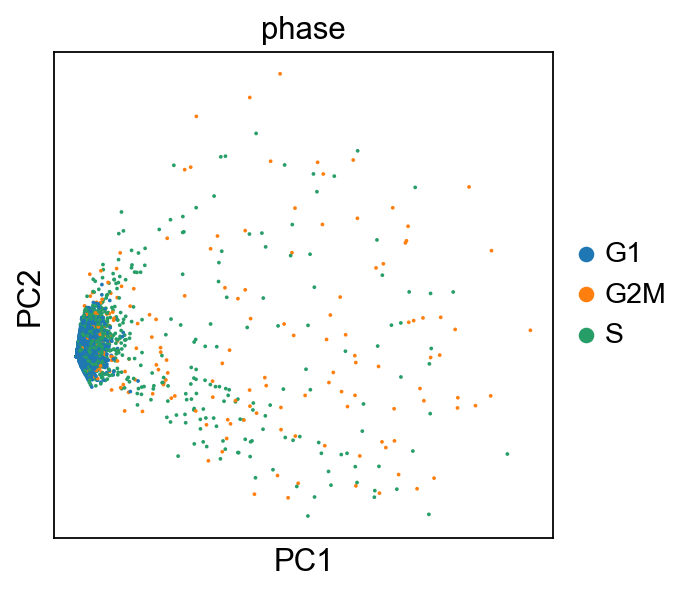

In [39]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

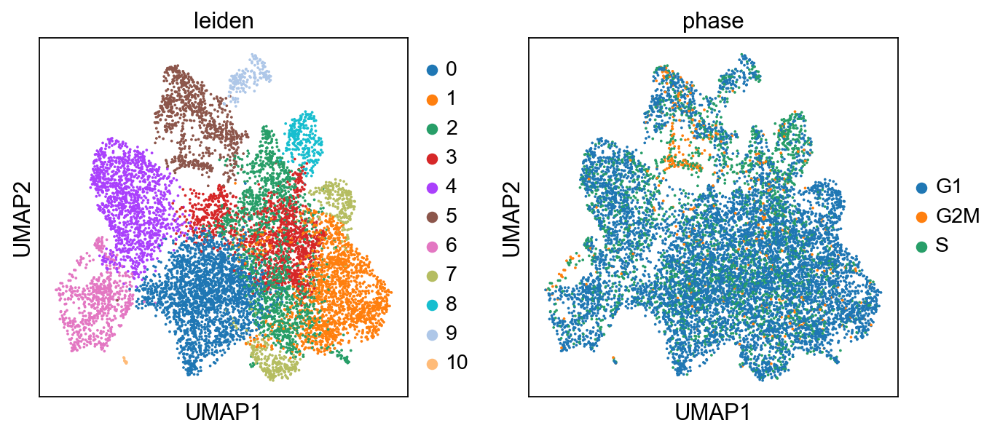

In [40]:
sc.pl.umap(adata, color=['leiden','phase'])

## Logistic Regression

In [41]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../../common_files/genes.joblib')

In [42]:
adata_log = adata[:,adata.var.index.isin(names)]

In [43]:
adata_names = [x for x in adata_log.var.index]

In [44]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [45]:
smartseq = anndata.read('../../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [46]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [47]:
names = [x for x in names_adata.var.index]

In [48]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [49]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[143,   5,   1,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  9,  68,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  68,   0,   0,   0,   7,   1,   0,   0,   0],
       [  0,   0,   3,   0, 182,   1,   0,   2,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   2,   0,   0,   3,   0,  55,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

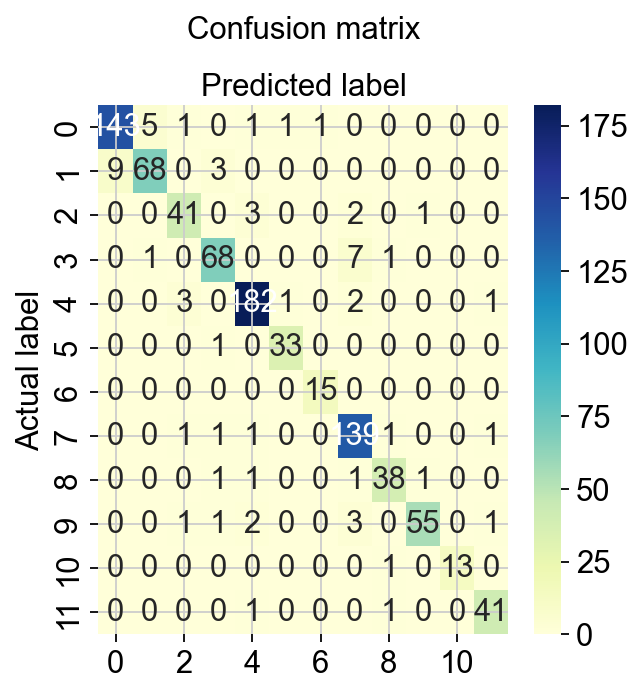

In [50]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [51]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.94      0.94      0.94       152
           2       0.92      0.85      0.88        80
           3       0.87      0.87      0.87        47
           4       0.91      0.88      0.89        77
           5       0.95      0.96      0.96       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.90      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.96      0.87      0.92        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.93       900
   macro avg       0.93      0.93      0.93       900
weighted avg       0.93      0.93      0.93       900



In [52]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [53]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

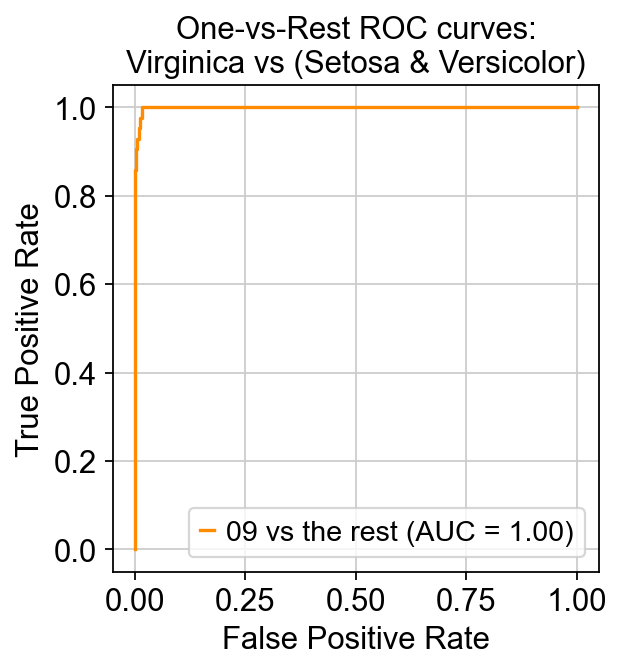

In [54]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [55]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [56]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [57]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.042872e-08,8.400744e-05,9.171184e-02,1.341572e-02,9.906063e-07,3.088753e-05,2.870993e-04,8.940686e-01,1.442838e-06,1.446747e-05,1.526745e-05,3.696546e-04,0.894069,0
1,01,01,9.999920e-01,1.844216e-07,1.062717e-08,8.424092e-08,9.047928e-08,9.367705e-07,6.611842e-06,2.648314e-10,2.320139e-09,5.824285e-09,9.771876e-08,5.480787e-09,0.999992,1
2,08,08,2.913410e-09,2.254433e-07,2.825933e-07,1.389826e-06,5.362072e-06,6.577555e-07,2.688205e-05,9.999195e-01,6.402329e-06,3.436253e-05,4.599225e-06,3.383186e-07,0.999919,1
3,10,10,3.837209e-08,6.688292e-06,2.463436e-05,3.061688e-07,4.962338e-01,6.913076e-04,6.570163e-05,3.677677e-05,2.874400e-04,5.016578e-01,7.192335e-05,9.234906e-04,0.501658,1
4,08,08,7.049792e-08,4.837009e-07,6.046432e-08,3.635971e-06,1.103861e-05,1.403048e-06,1.142306e-04,9.995012e-01,3.377247e-04,1.705490e-05,6.716438e-06,6.372477e-06,0.999501,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.235654e-04,1.533684e-07,2.857660e-06,2.801752e-05,9.896546e-01,5.150348e-03,3.136822e-04,2.066728e-03,7.731650e-04,1.611079e-03,1.641222e-04,1.172047e-05,0.989655,1
896,05,05,2.377044e-10,2.423963e-07,1.769870e-07,1.257694e-07,9.999885e-01,5.537004e-06,2.671743e-07,3.650775e-10,9.386394e-08,2.174304e-07,4.147241e-06,7.053618e-07,0.999988,1
897,08,08,2.158098e-06,6.564939e-05,8.142905e-06,1.266414e-02,4.393420e-08,4.531442e-06,9.837689e-05,9.856503e-01,1.307396e-03,1.518656e-04,2.082154e-05,2.662295e-05,0.985650,1
898,05,05,4.812155e-11,1.118685e-07,2.290677e-06,4.385233e-12,9.999968e-01,2.984659e-08,1.875097e-07,2.328133e-07,3.702460e-08,4.928294e-08,2.099643e-07,6.275191e-08,0.999997,1


In [58]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.33-0.88,0.333872,0.879925,0.689922
1,0.88-0.98,0.879925,0.981788,0.882812
2,0.98-1.0,0.981788,0.996751,0.945736
3,1.0-1.0,0.999074,0.999884,0.996109


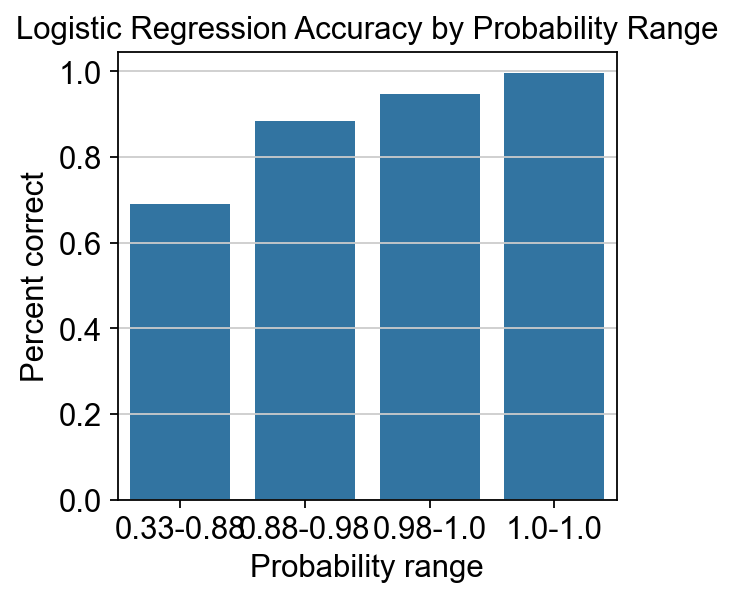

In [59]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [60]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

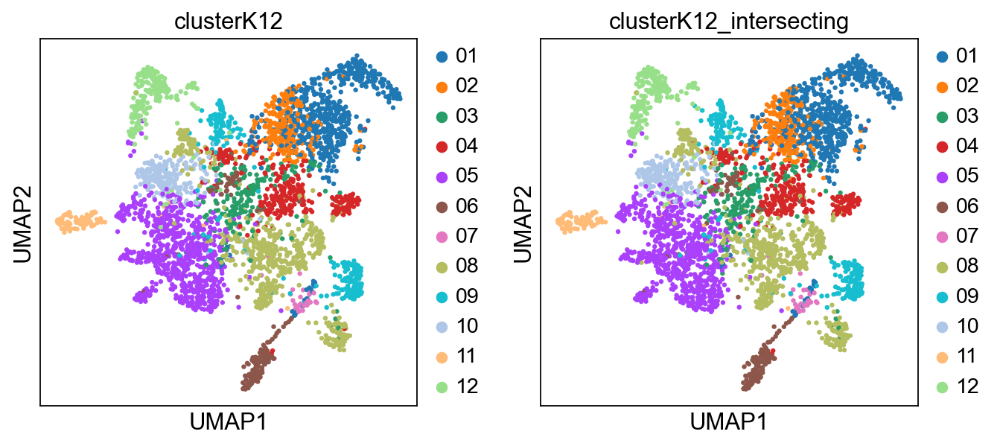

In [61]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [62]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [63]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9822222222222222

In [64]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.263341e-12,1.366295e-10,9.829184e-11,3.198102e-13,1.511855e-08,3.501808e-11,4.094469e-09,1.048482e-11,1.286256e-10,8.673617e-11,1.000000e+00,1.135313e-09,1.000000
1,12,1.767643e-10,2.087050e-11,7.845635e-11,1.842642e-09,2.410773e-09,8.024121e-07,1.707914e-08,3.519044e-08,7.912136e-08,3.894244e-07,8.151838e-09,9.999987e-01,0.999999
2,05,8.970702e-04,2.215294e-07,3.684373e-04,1.699660e-07,9.987119e-01,1.692832e-05,6.472426e-07,1.074380e-10,2.116781e-07,1.066564e-06,8.514649e-07,2.482191e-06,0.998712
3,10,5.442384e-07,5.133278e-07,5.588117e-07,1.697881e-03,6.491889e-07,9.661696e-06,7.999039e-06,4.000473e-03,8.685171e-06,9.942495e-01,4.632504e-06,1.885879e-05,0.994250
4,01,9.999960e-01,6.035680e-09,1.673615e-06,1.823958e-06,8.966211e-09,1.011932e-07,7.249206e-08,2.593000e-10,1.397018e-10,7.838554e-09,3.190739e-07,1.607993e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,2.590390e-10,6.522442e-08,5.537839e-09,1.021888e-07,9.898337e-09,5.762458e-09,4.415700e-07,9.999963e-01,2.904439e-06,9.953209e-08,4.584424e-08,7.220356e-09,0.999996
3596,09,6.662431e-08,1.814316e-07,8.484288e-08,8.745287e-08,1.028003e-06,4.102350e-08,1.091345e-06,2.051489e-04,9.997894e-01,1.863994e-07,2.627027e-06,9.584341e-08,0.999789
3597,08,3.347466e-08,3.842864e-06,7.808606e-08,3.937820e-05,2.108116e-08,5.139853e-08,6.765161e-06,9.998392e-01,1.055187e-04,2.288359e-06,2.026802e-06,8.295476e-07,0.999839
3598,08,7.337753e-09,2.145731e-06,2.935133e-06,1.578014e-06,4.650991e-04,2.275014e-07,1.057761e-05,9.994860e-01,1.106114e-05,1.421817e-05,4.197862e-06,1.987158e-06,0.999486


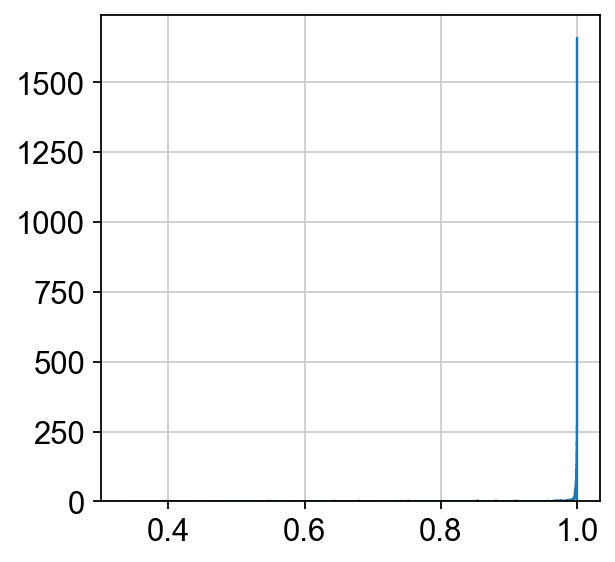

In [65]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [66]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [67]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [68]:
y_pred = logreg.predict(adata_log_ordered.X)

In [69]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [70]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

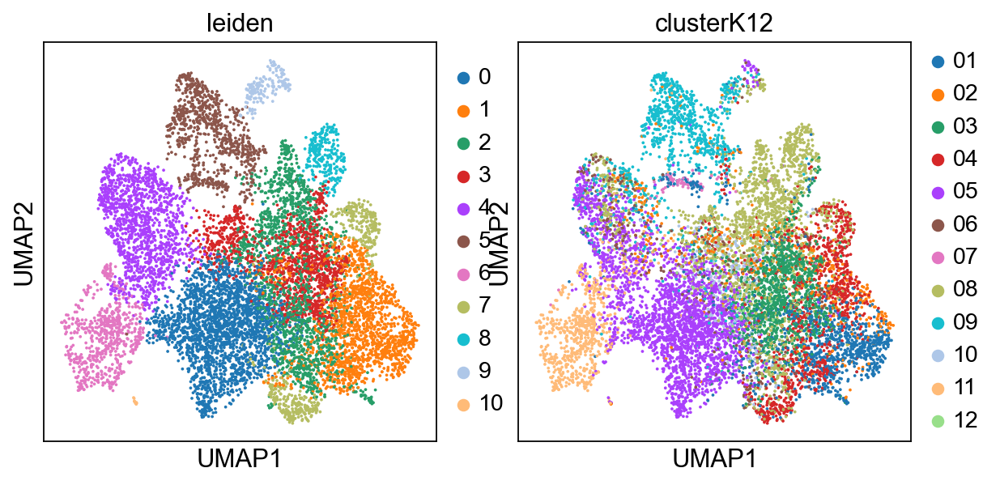

In [71]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

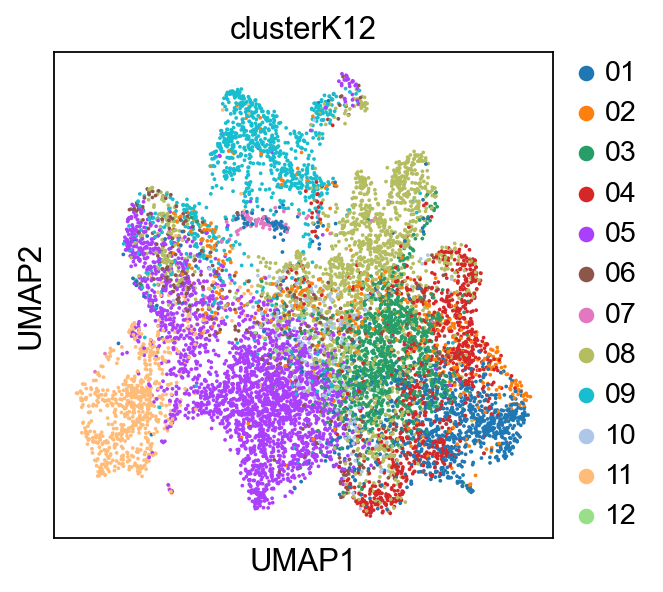

In [72]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

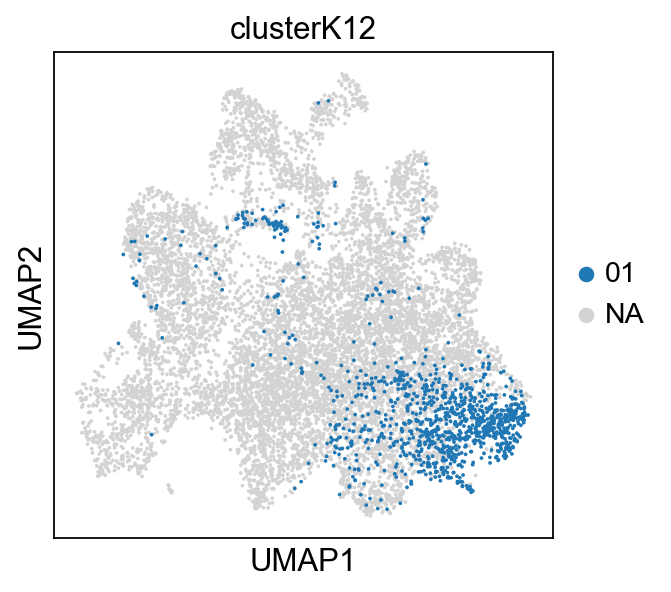

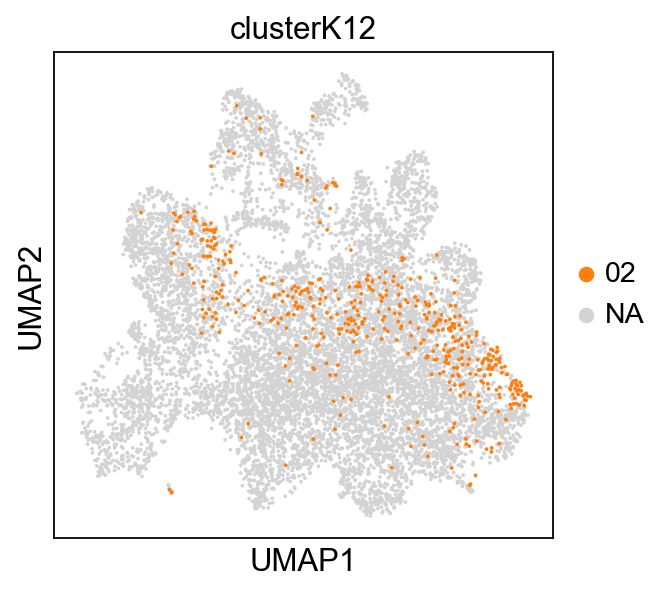

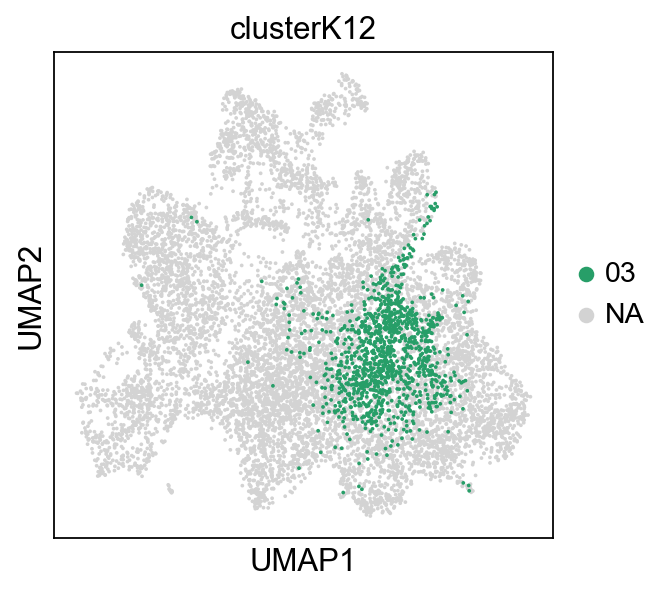

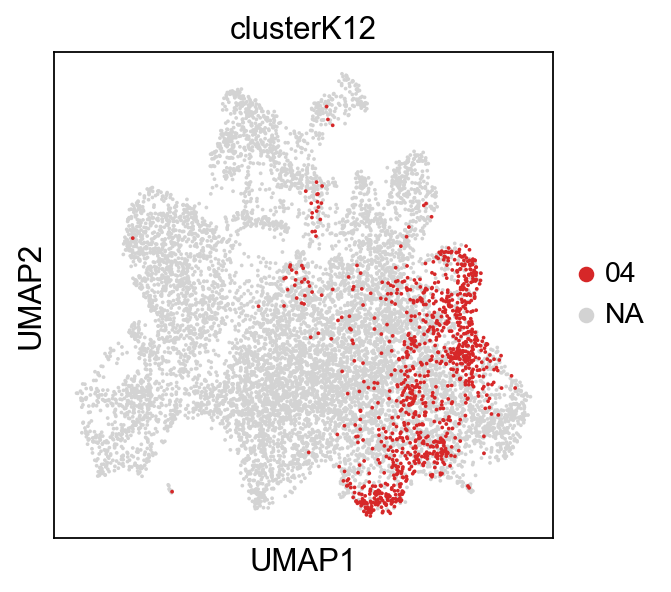

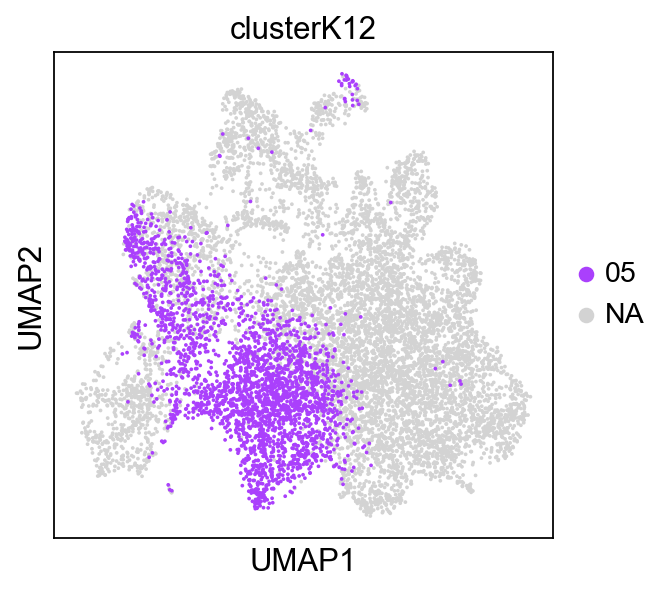

...

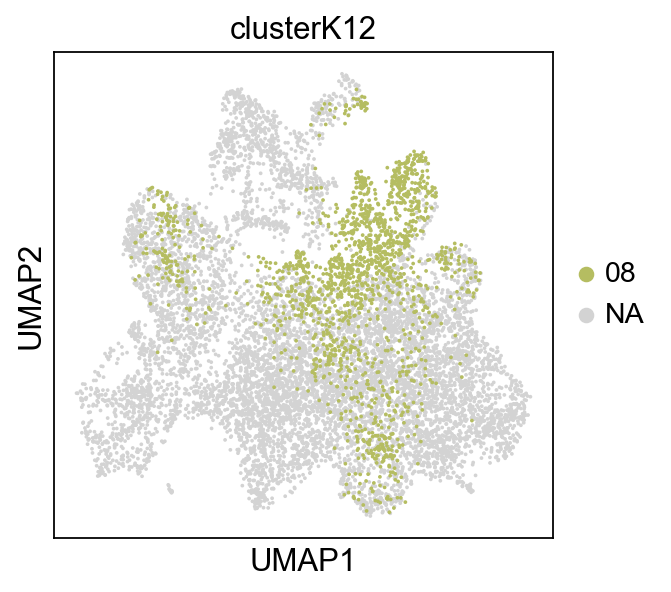

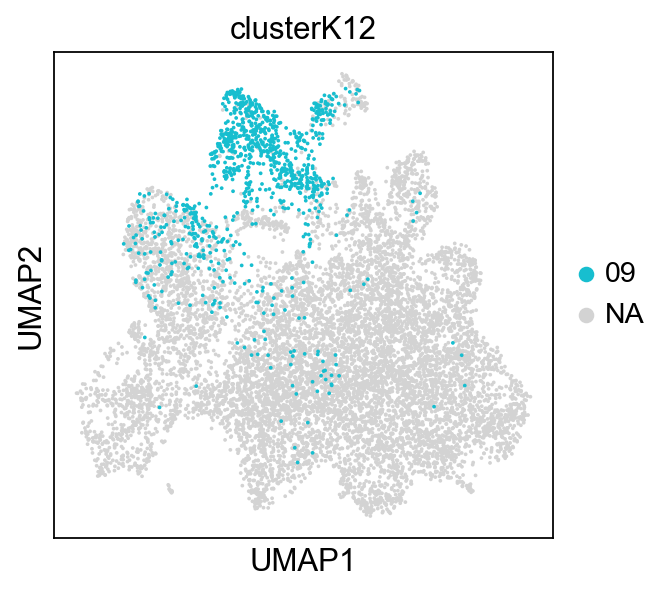

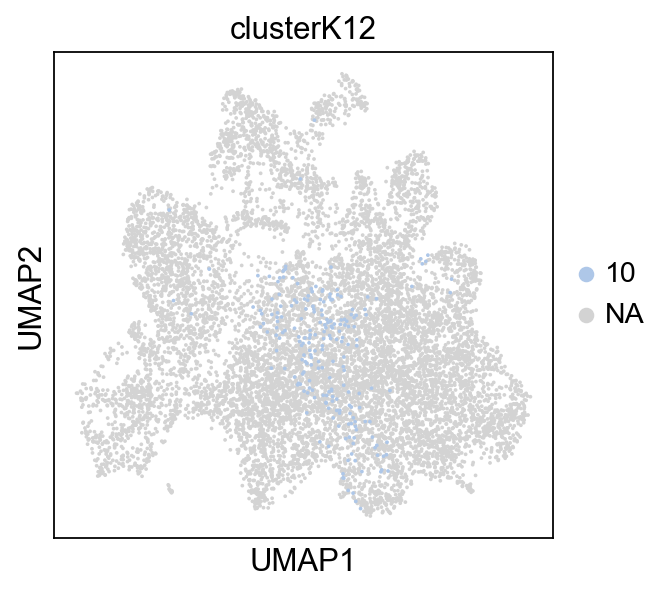

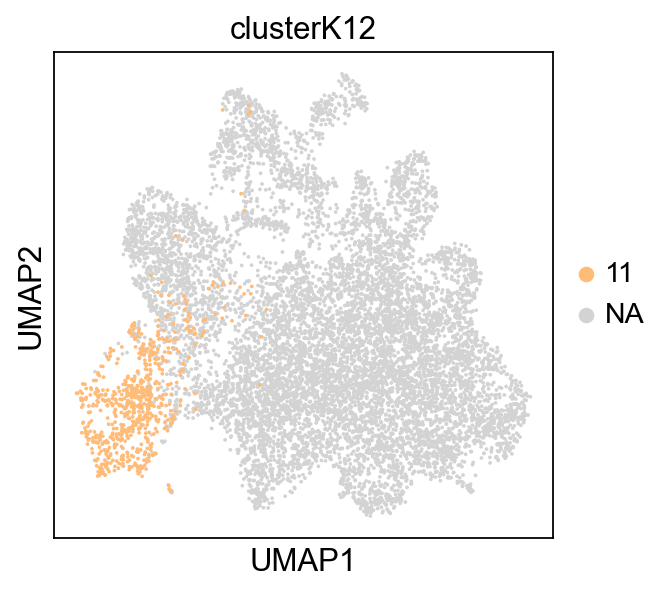

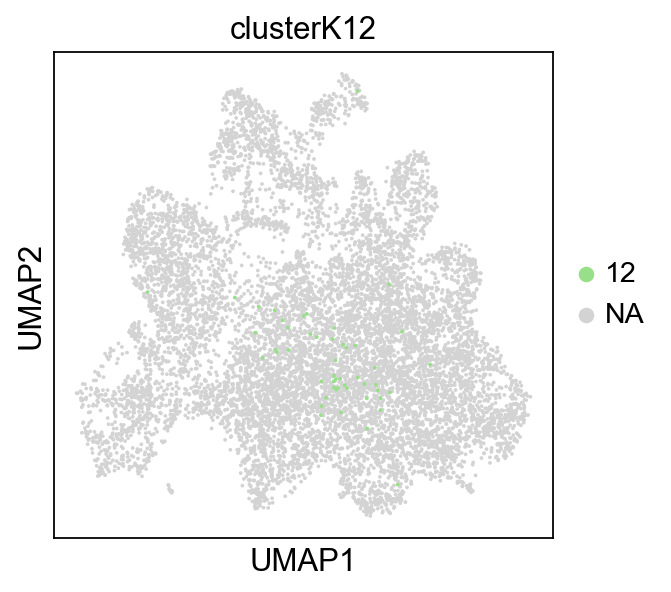

In [73]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [74]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

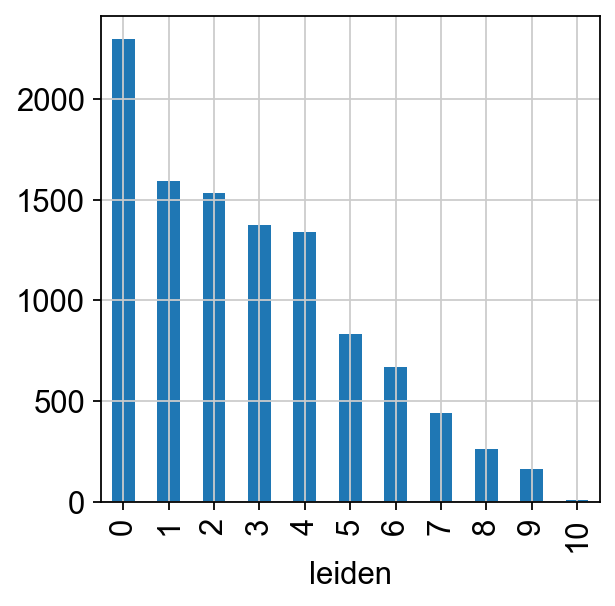

In [75]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

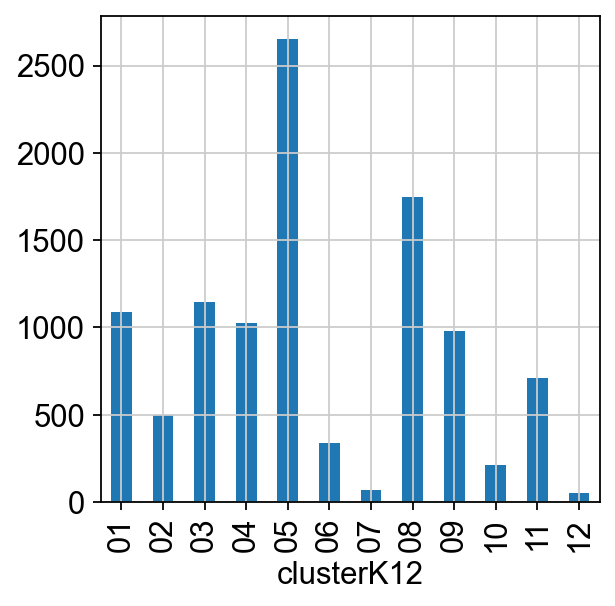

In [76]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

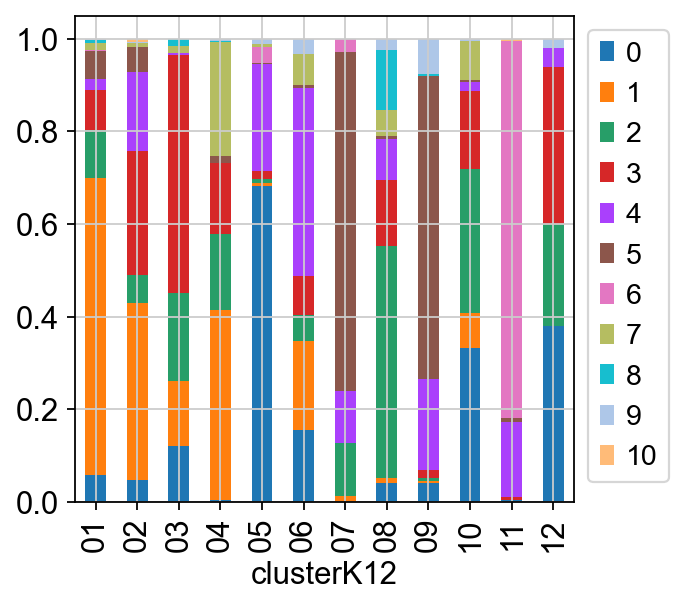

In [77]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [78]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,09,6.931007e-06,0.015661,2.503606e-05,4.633625e-06,4.188362e-04,1.963236e-04,4.360143e-05,1.135654e-05,9.834620e-01,8.885021e-05,7.371873e-05,7.453509e-06,0.983462
1,11,4.240816e-08,0.000009,3.225231e-07,4.871221e-09,1.634953e-05,3.195487e-08,8.216467e-06,8.213207e-08,3.630870e-06,2.336989e-07,9.999620e-01,5.224769e-07,0.999962
2,06,7.501498e-05,0.002738,5.125193e-04,9.381368e-04,3.362282e-03,9.818957e-01,1.472093e-03,7.813074e-04,4.992165e-04,4.842394e-03,1.335647e-03,1.547776e-03,0.981896
3,01,4.215821e-01,0.014963,4.643346e-02,3.083431e-01,7.990427e-05,8.526753e-02,1.070948e-02,1.441097e-03,1.366848e-02,1.116650e-02,2.011760e-03,8.433388e-02,0.421582
4,03,2.504874e-11,0.000006,9.999938e-01,5.531351e-08,3.658303e-11,2.188274e-08,1.490895e-09,2.303537e-09,2.353604e-10,1.026647e-09,2.117686e-09,7.235966e-09,0.999994
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10516,09,6.706196e-03,0.001990,5.950404e-02,8.198624e-04,7.475724e-02,1.023349e-02,7.794719e-03,8.334023e-02,5.789939e-01,1.042016e-01,4.804535e-03,6.685380e-02,0.578994
10517,04,1.126451e-03,0.000692,1.049829e-05,8.371312e-01,7.503470e-09,8.105971e-05,6.543847e-04,1.596489e-01,6.358886e-05,8.859846e-05,7.529321e-05,4.278646e-04,0.837131
10518,05,4.893416e-03,0.079885,7.736869e-02,1.402470e-02,5.281988e-01,1.312795e-01,1.983507e-02,6.420138e-04,1.578258e-03,1.090450e-01,1.053855e-02,2.271128e-02,0.528199
10519,10,1.040090e-01,0.000184,3.268600e-03,6.388013e-02,1.881460e-01,6.440000e-02,1.677334e-02,1.799604e-01,2.132569e-02,3.465927e-01,4.324406e-03,7.135375e-03,0.346593


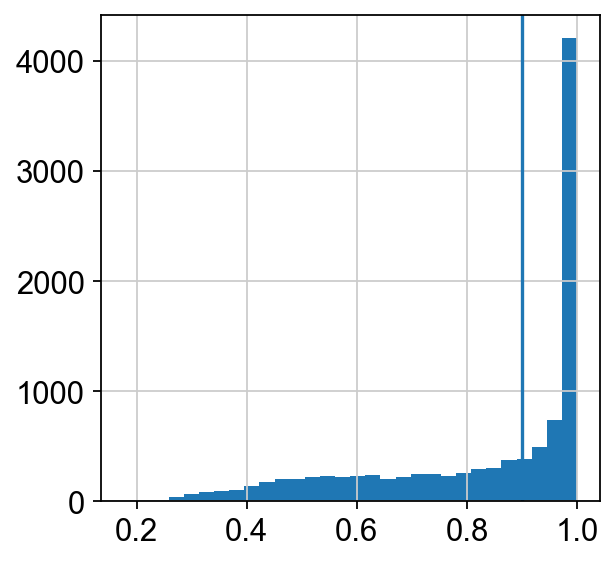

In [79]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [80]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.18-0.55,0.175,0.548
1,0.55-0.73,0.548,0.728
2,0.73-0.88,0.728,0.875
3,0.88-0.96,0.875,0.963
4,0.96-0.99,0.963,0.993
5,0.99-1.0,0.993,0.999
6,1.0-1.0,0.999,1.000


In [81]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [82]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCGCATCATAGA-1-First        09
AAACCCGCATCCCGTG-1-First        11
AAACCCTGTAGTCAAG-1-First        06
AAACCGCTCTATCACC-1-First     other
AAACCGCTCTCACATC-1-First        03
                             ...  
TGTGCTGGTGGACATA-1-Second    other
TGTGGTCAGGAATCGG-1-Second       04
TGTGTACGTCAGTCAT-1-Second    other
TGTGTACGTCTGGGTC-1-Second    other
TGTGTTAGTTGAGCTT-1-Second       01
Name: clusterK12_stringent, Length: 10521, dtype: object

In [83]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

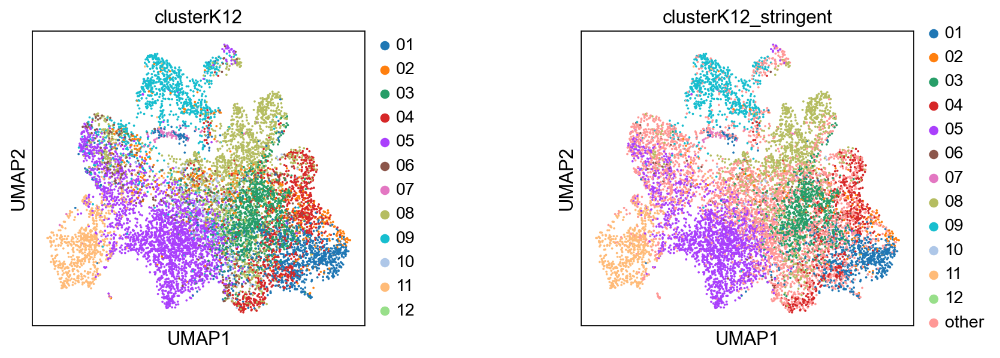

In [84]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

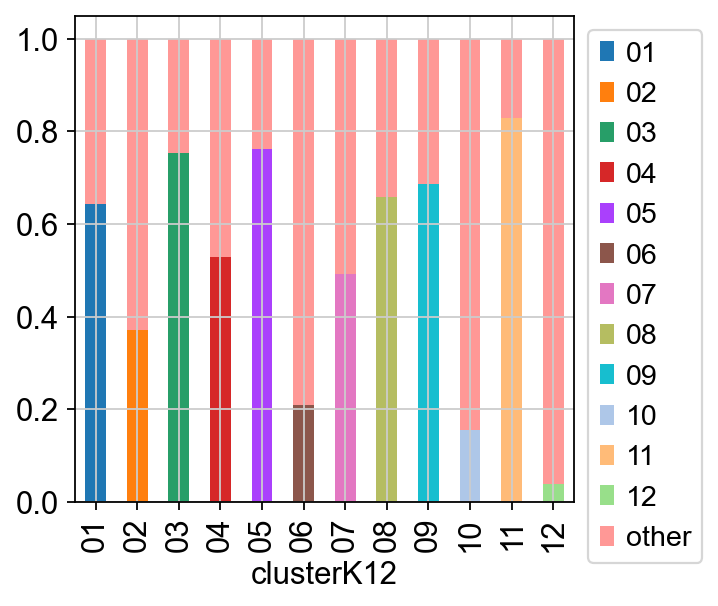

In [85]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

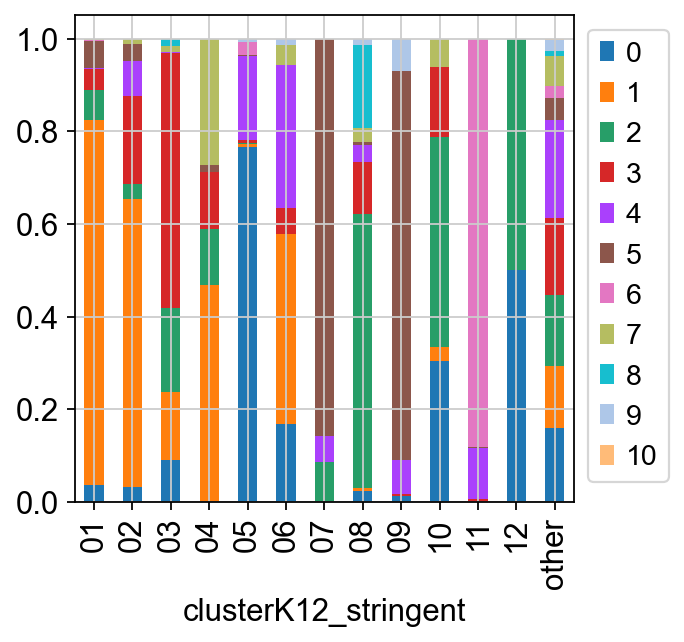

In [86]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

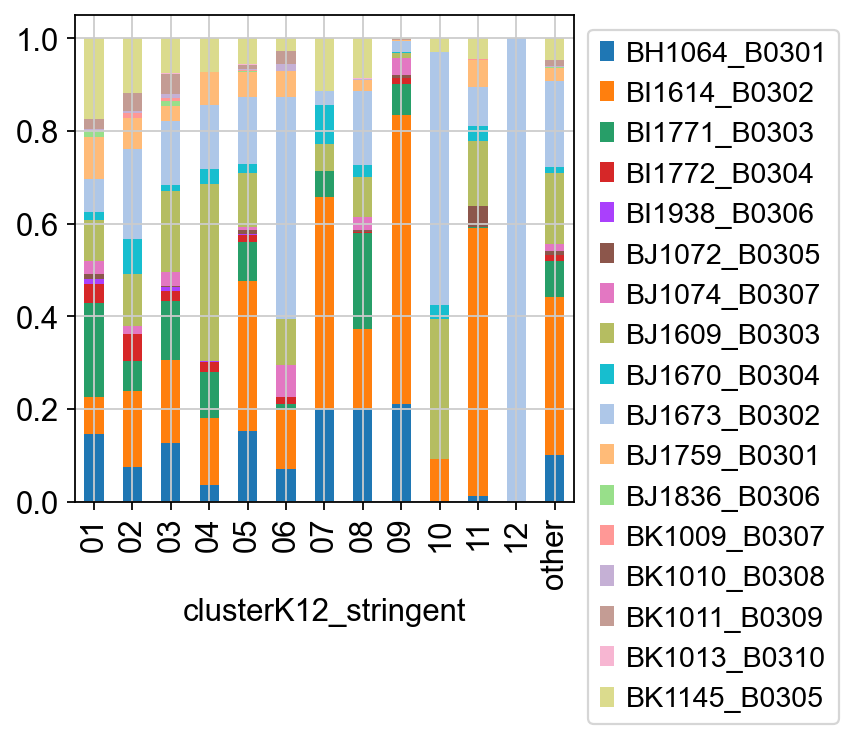

In [87]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

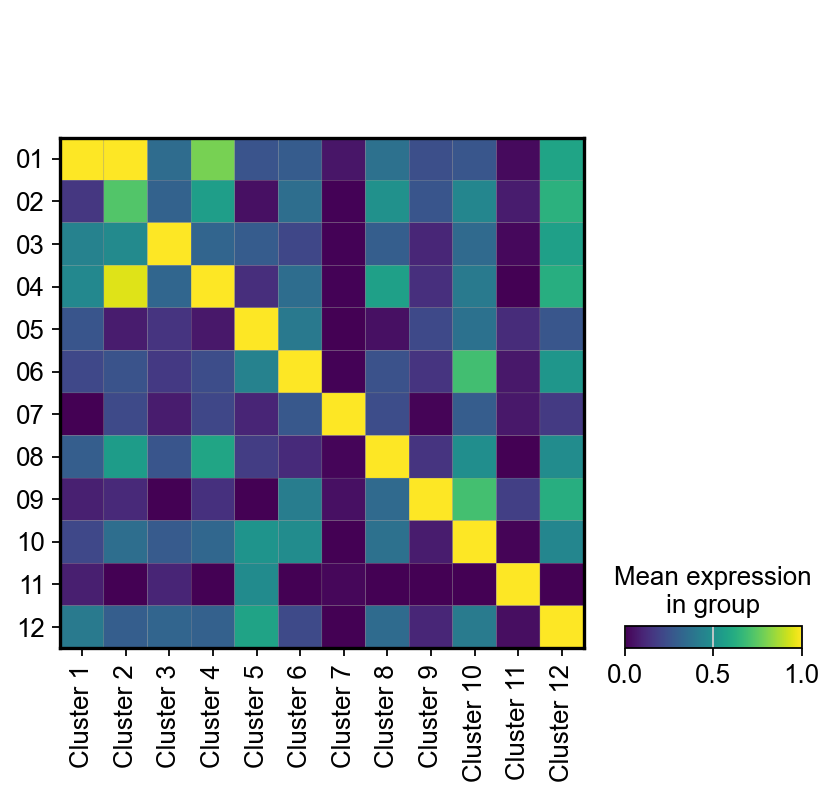

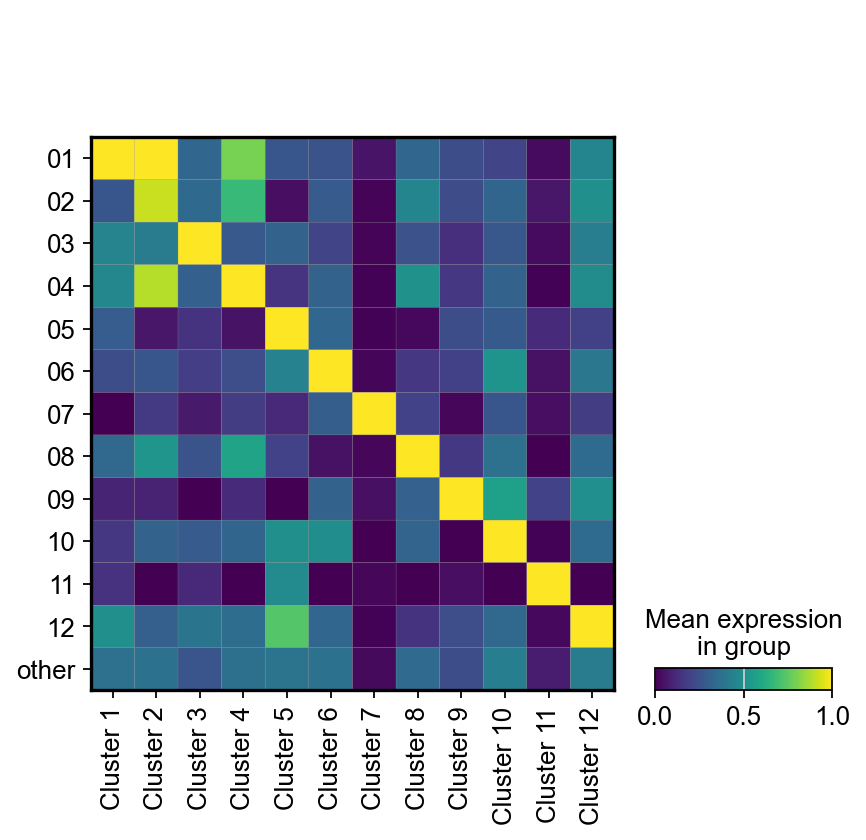

In [88]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

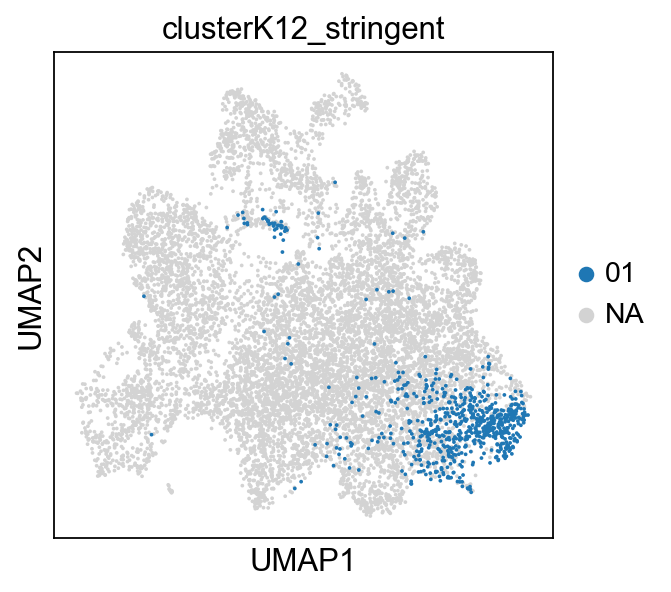

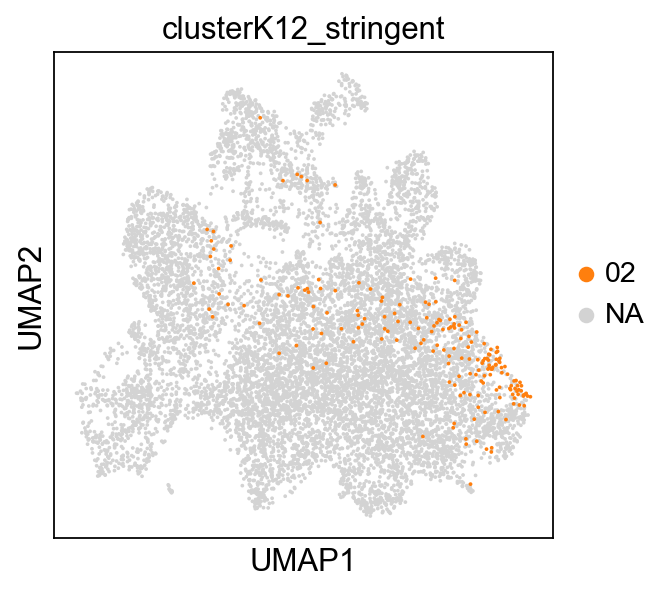

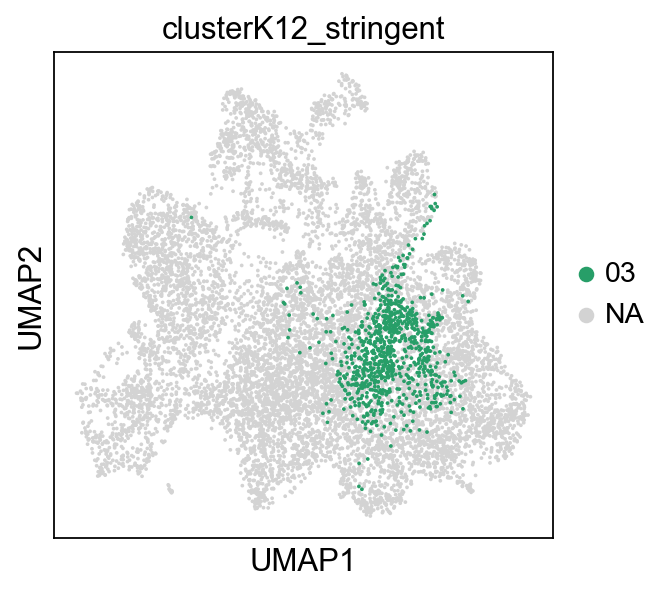

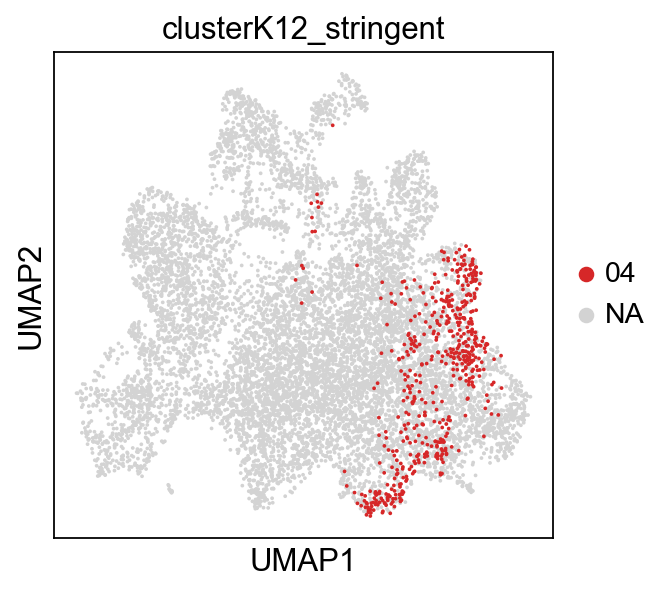

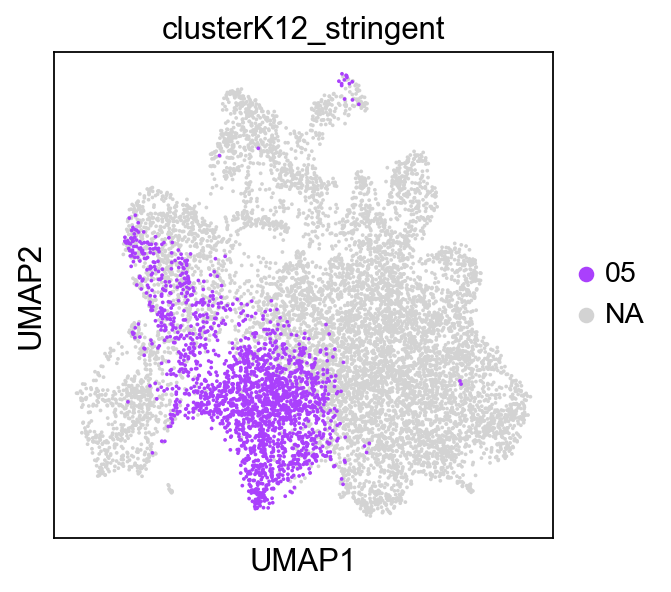

...

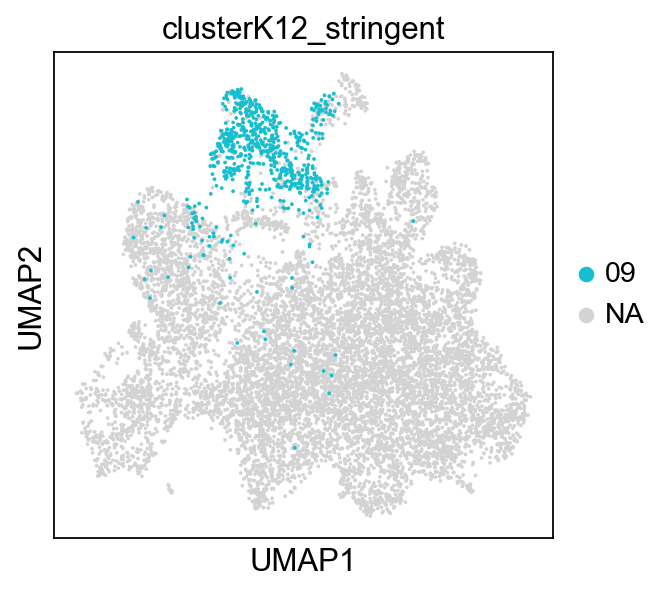

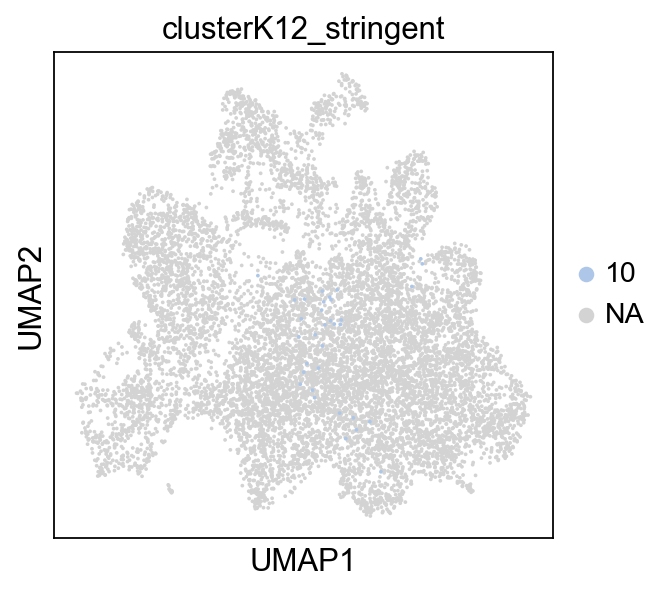

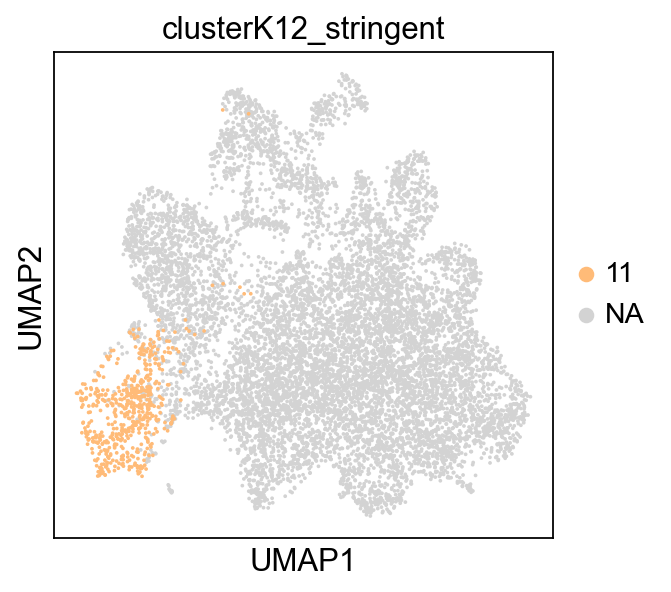

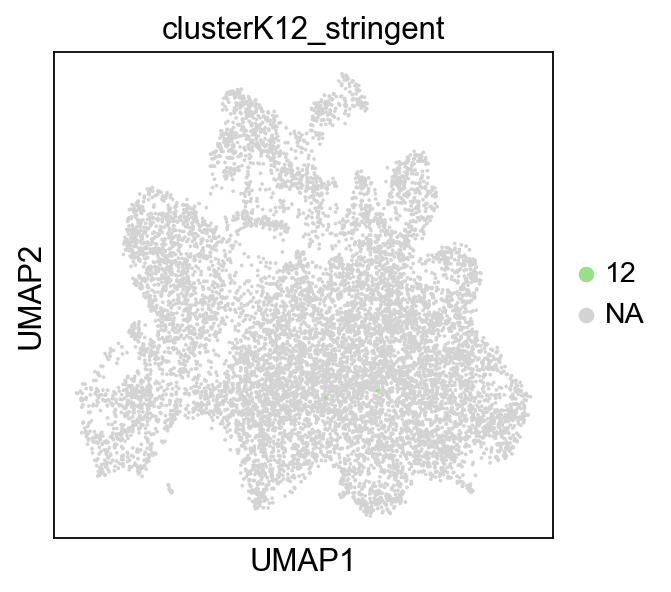

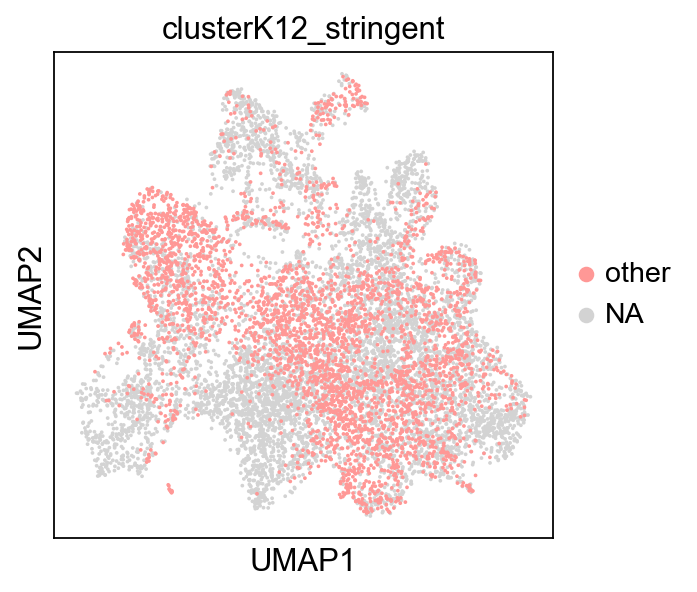

In [89]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [90]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
05    2653
08    1745
03    1147
01    1091
04    1023
09     982
11     708
02     498
06     340
10     213
07      71
12      50
Name: count, dtype: int64

In [91]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

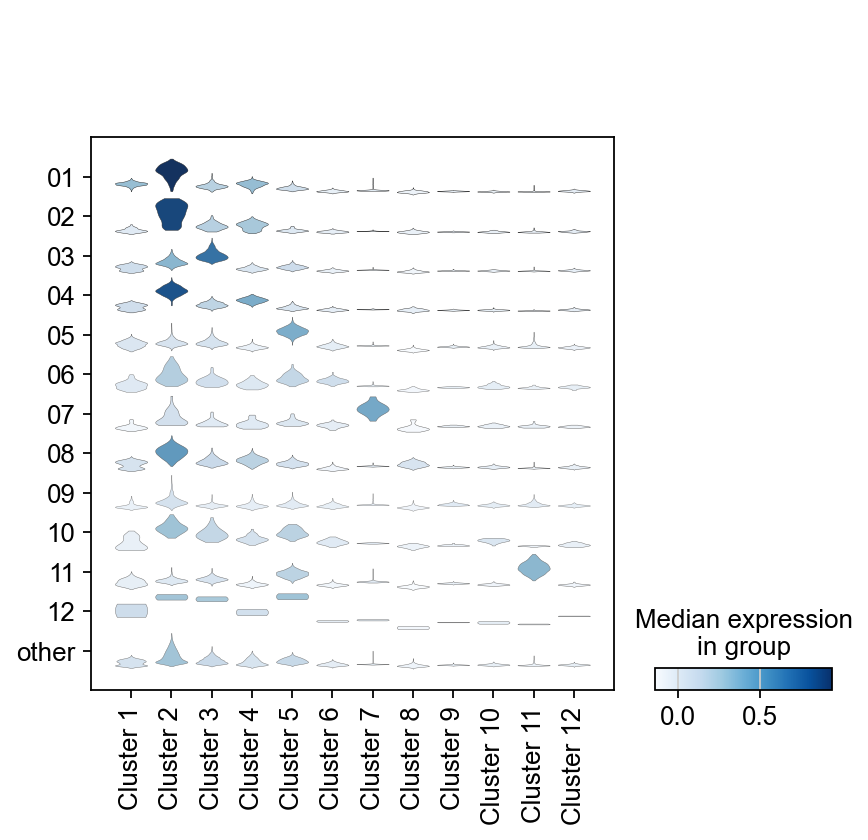

In [92]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

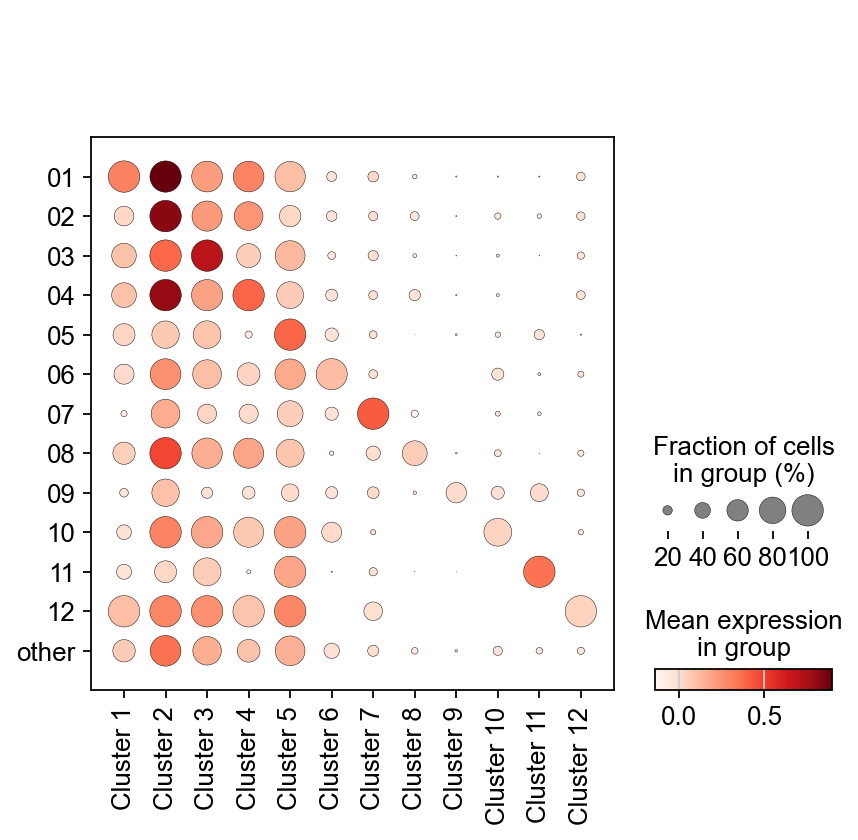

In [93]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

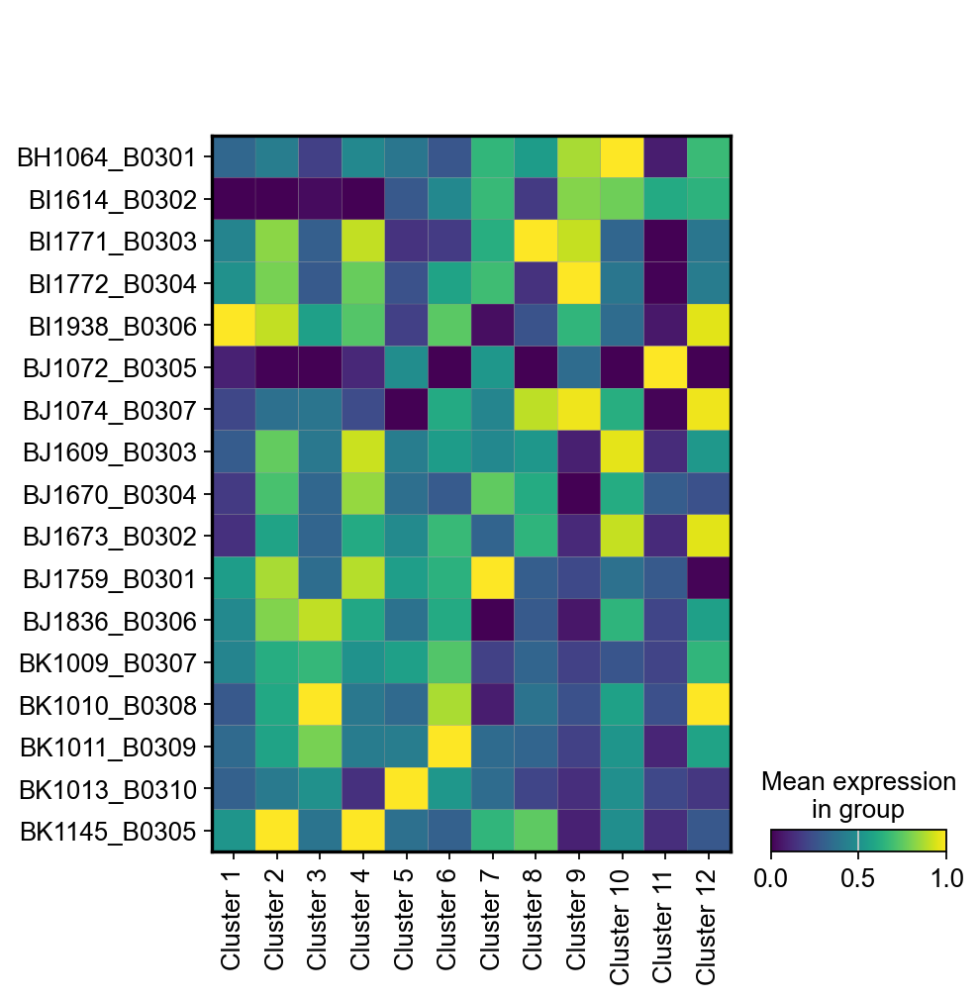

In [94]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [95]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

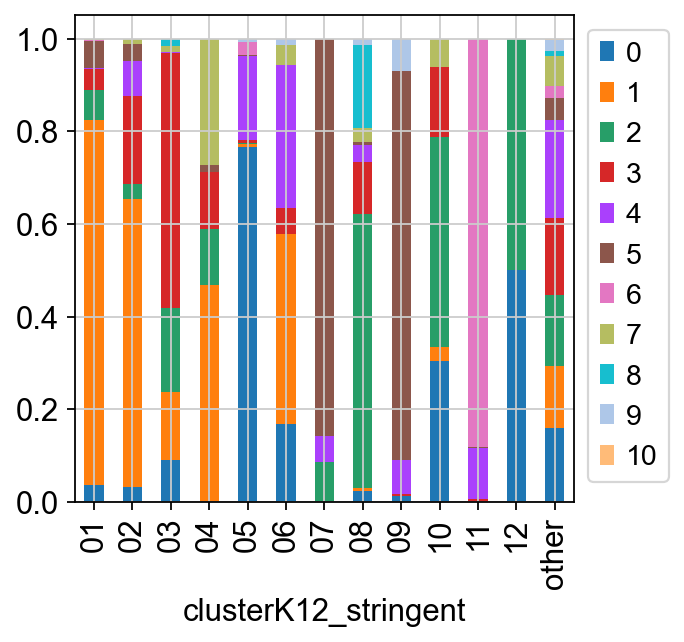

In [96]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

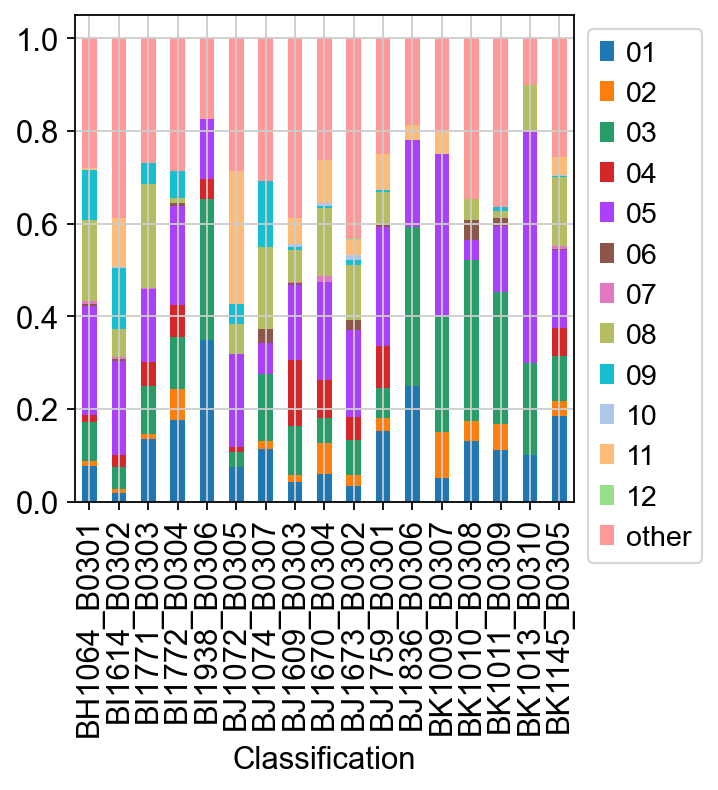

In [97]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

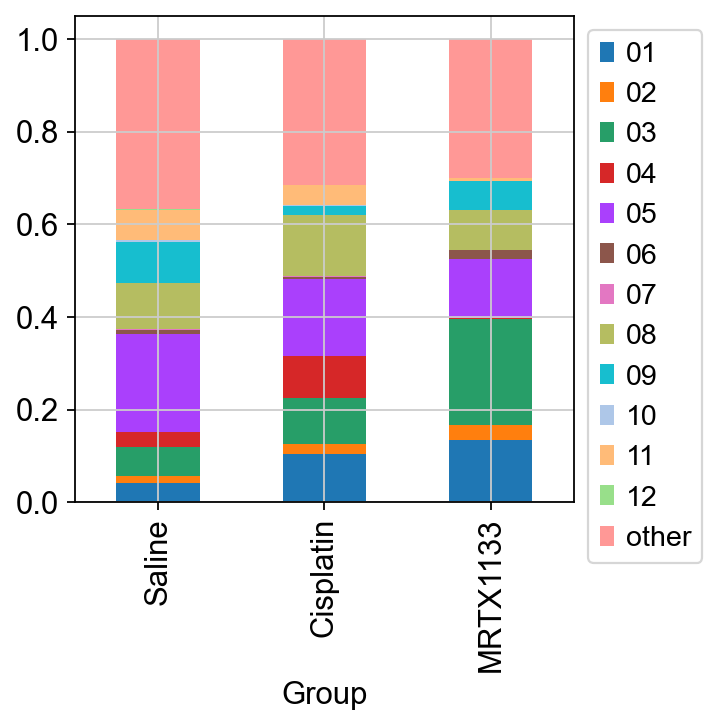

In [98]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

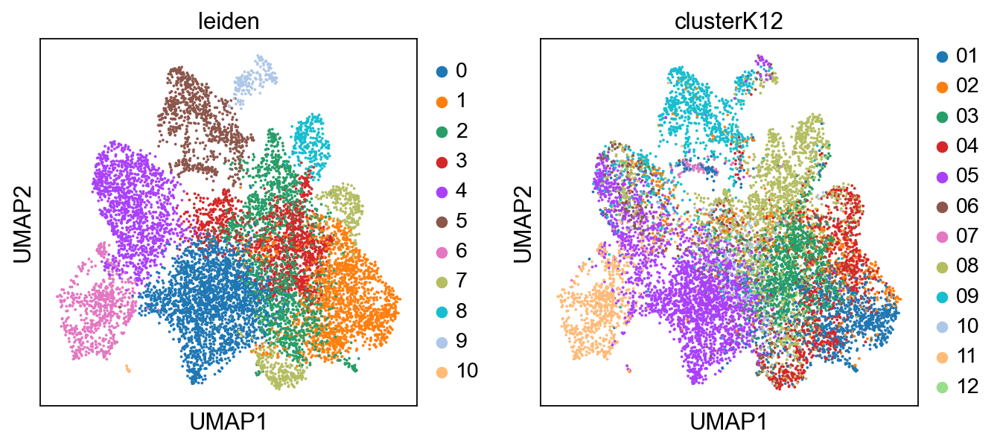

In [99]:
sc.pl.umap(adata, color=['leiden','clusterK12'])

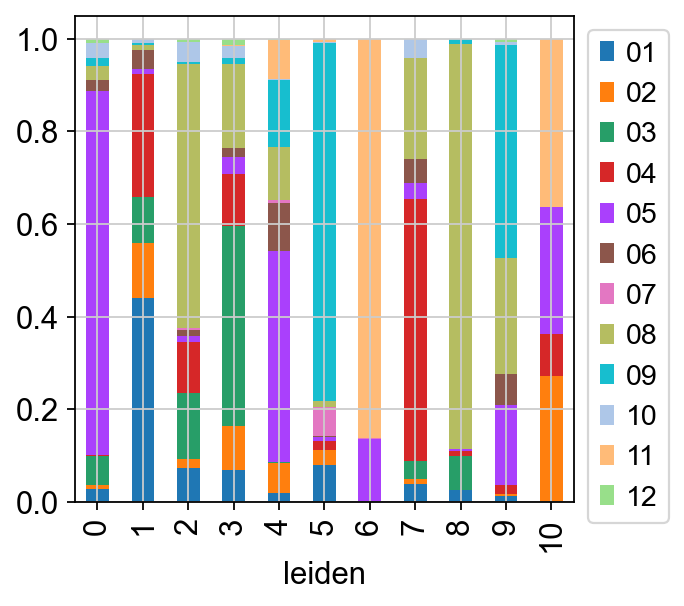

In [100]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

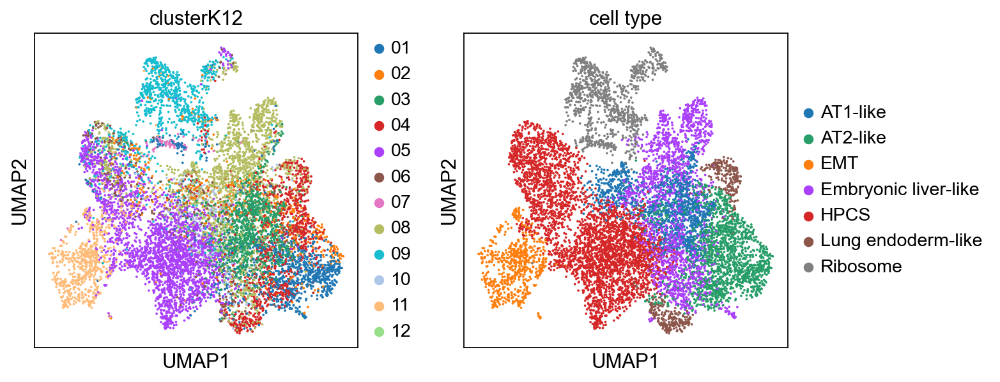

In [104]:
cluster2annotation = {
    "0": "HPCS",
    "1": "AT2-like",
    "2": "Embryonic liver-like",
    "3": "AT1-like",
    "4": "HPCS",
    "5": "Ribosome",
    "6": "EMT",
    "7": "Lung endoderm-like",
    "8": "Embryonic liver-like",
    "9": "Ribosome",
    "10": "EMT"
}
adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")

adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#ff7f0e', '#aa40fc','#d62728','#8c564b','gray']
#sc.pl.umap(adata, color=['clusterK12','cell type'])

#adata.uns['cell type_colors'] = ['#1f77b4','#279e68','#ff7f0e', '#8c564b', '#d62728', '#e377c2', '#aa40fc']
sc.pl.umap(adata, color=['clusterK12','cell type'])

## Evaluate stringency

In [105]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_77596/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [106]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCGCATCATAGA-1-First        09
AAACCCGCATCCCGTG-1-First        11
AAACCCTGTAGTCAAG-1-First        06
AAACCGCTCTATCACC-1-First     other
AAACCGCTCTCACATC-1-First        03
                             ...  
TGTGCTGGTGGACATA-1-Second    other
TGTGGTCAGGAATCGG-1-Second       04
TGTGTACGTCAGTCAT-1-Second    other
TGTGTACGTCTGGGTC-1-Second    other
TGTGTTAGTTGAGCTT-1-Second       01
Name: clusterK12_stringent, Length: 10521, dtype: object

In [107]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

In [108]:
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

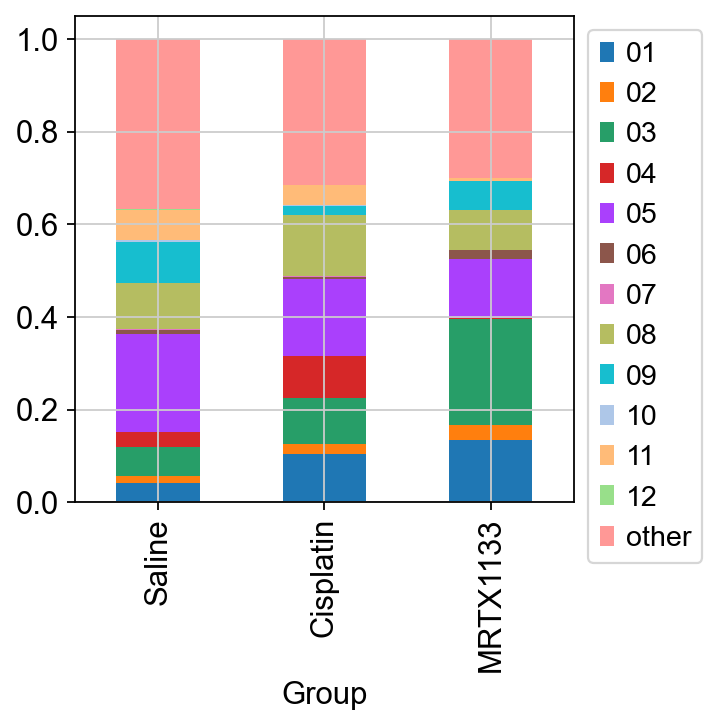

In [109]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

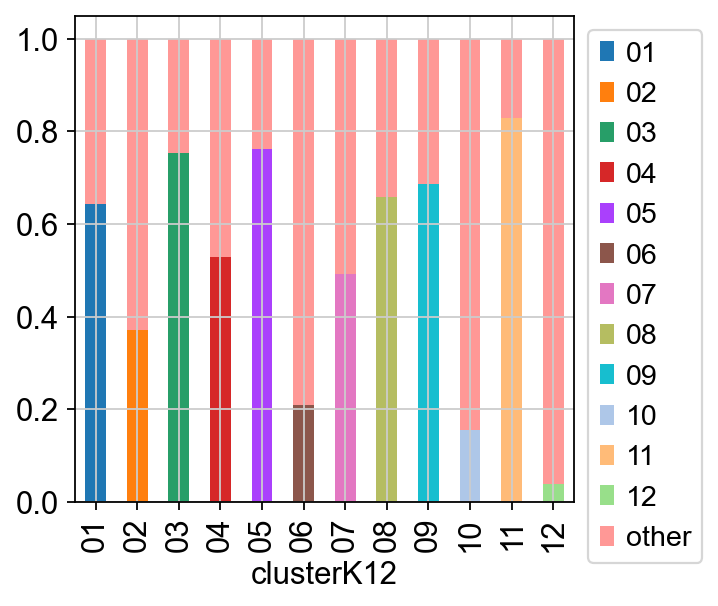

In [110]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [111]:
adata.write_h5ad(results_file)

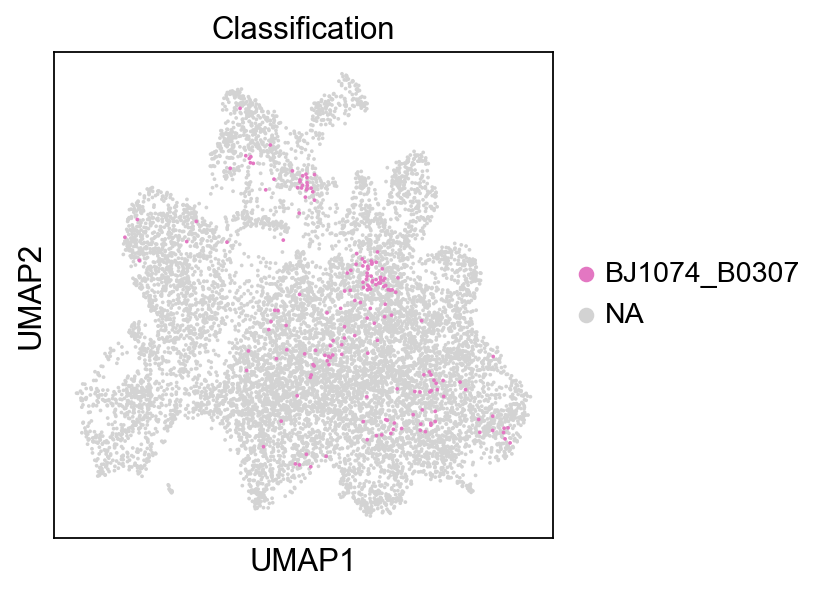

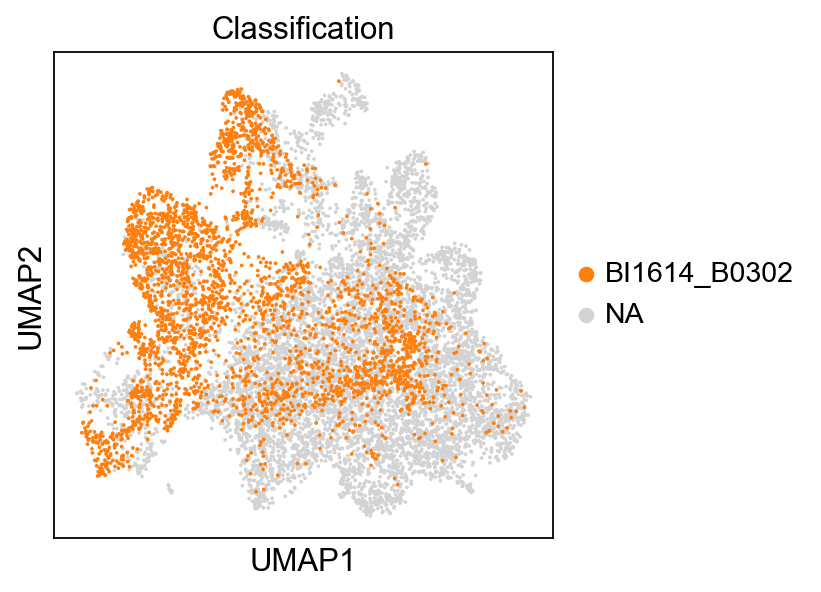

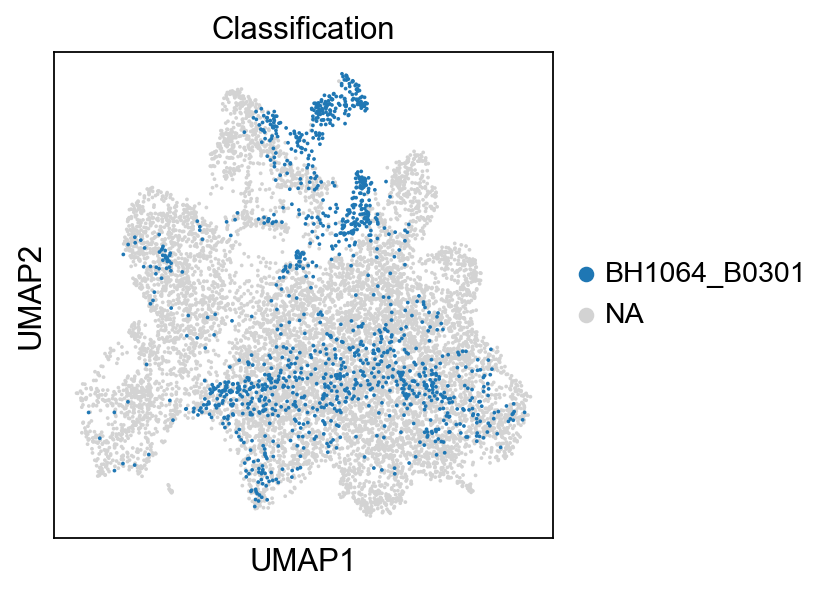

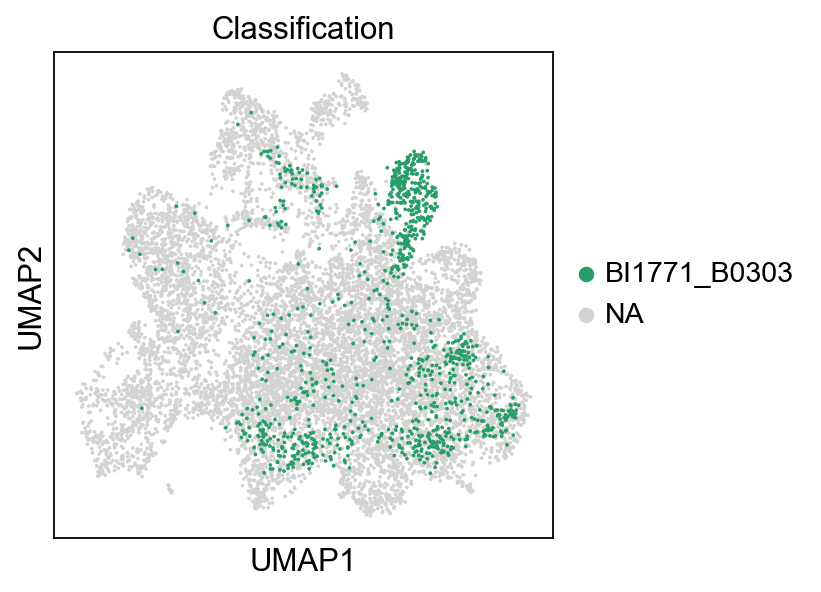

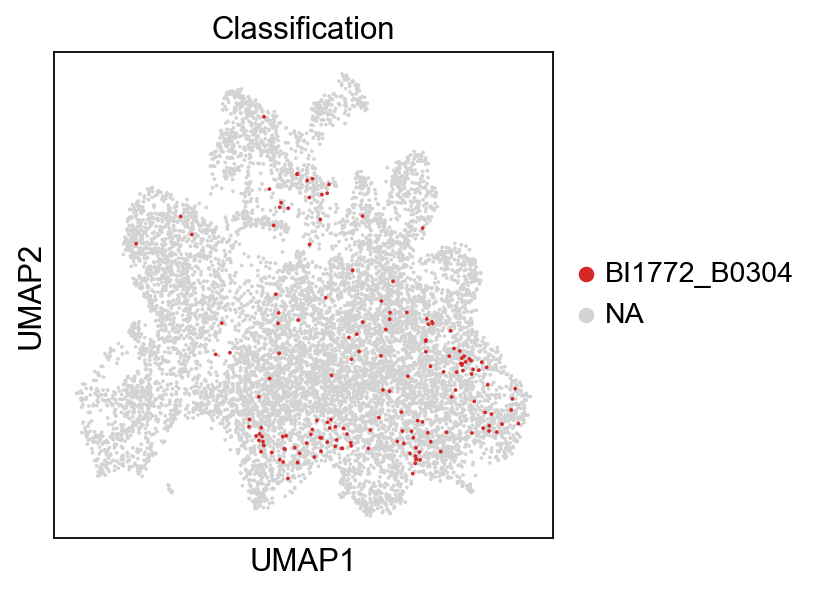

...

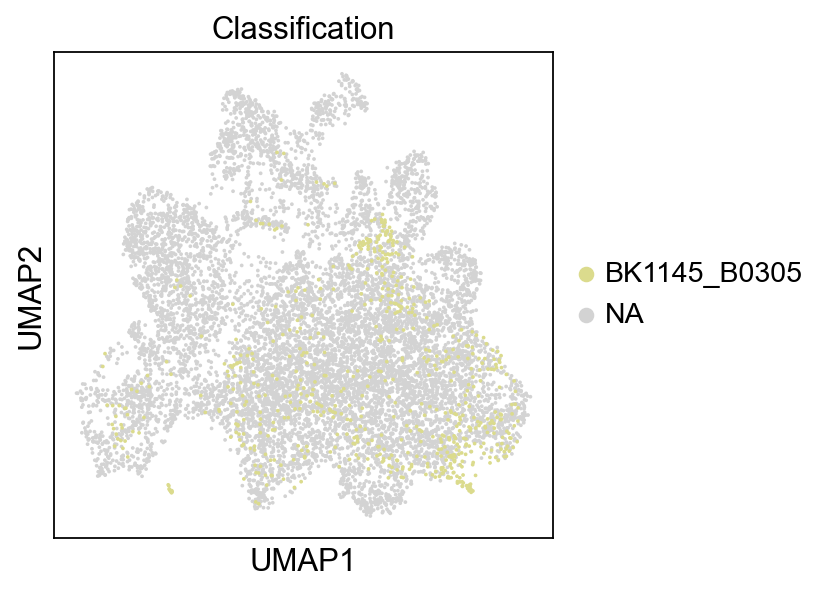

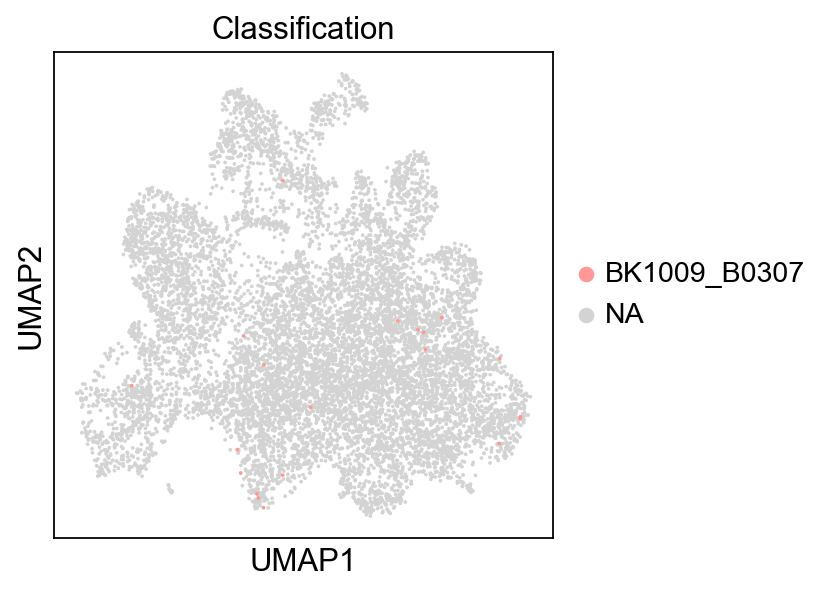

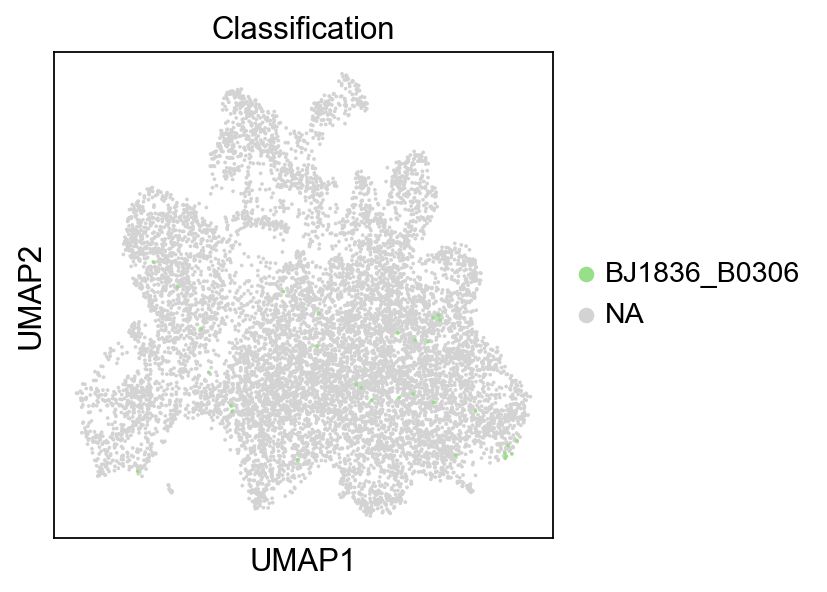

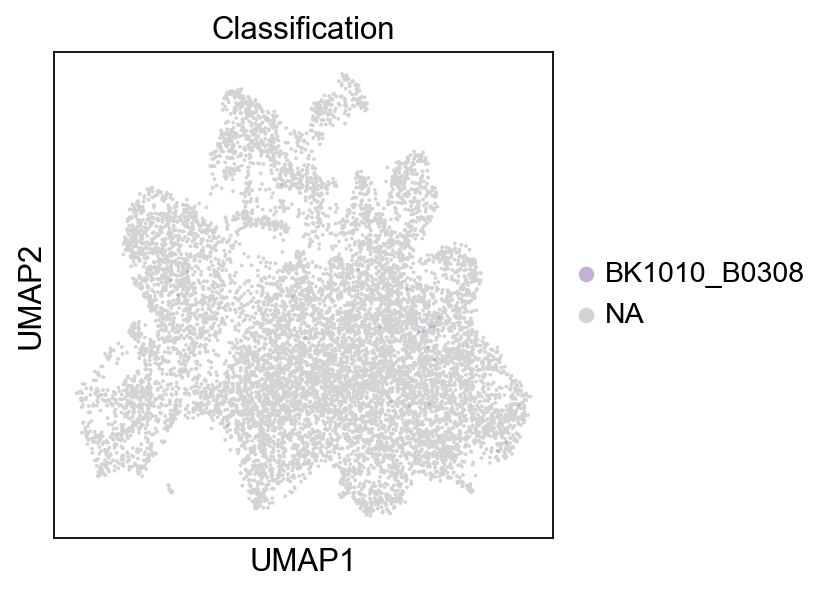

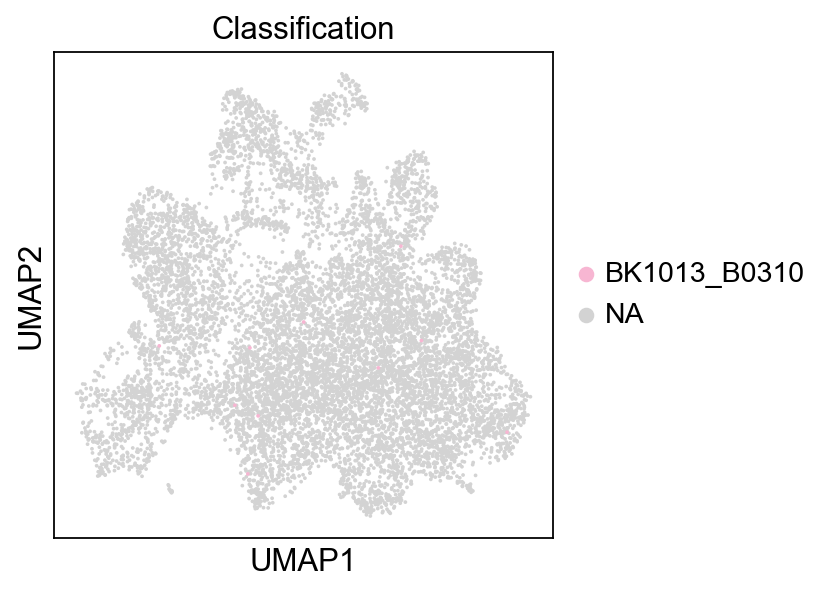

In [112]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [113]:
sc.tl.embedding_density(adata,basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


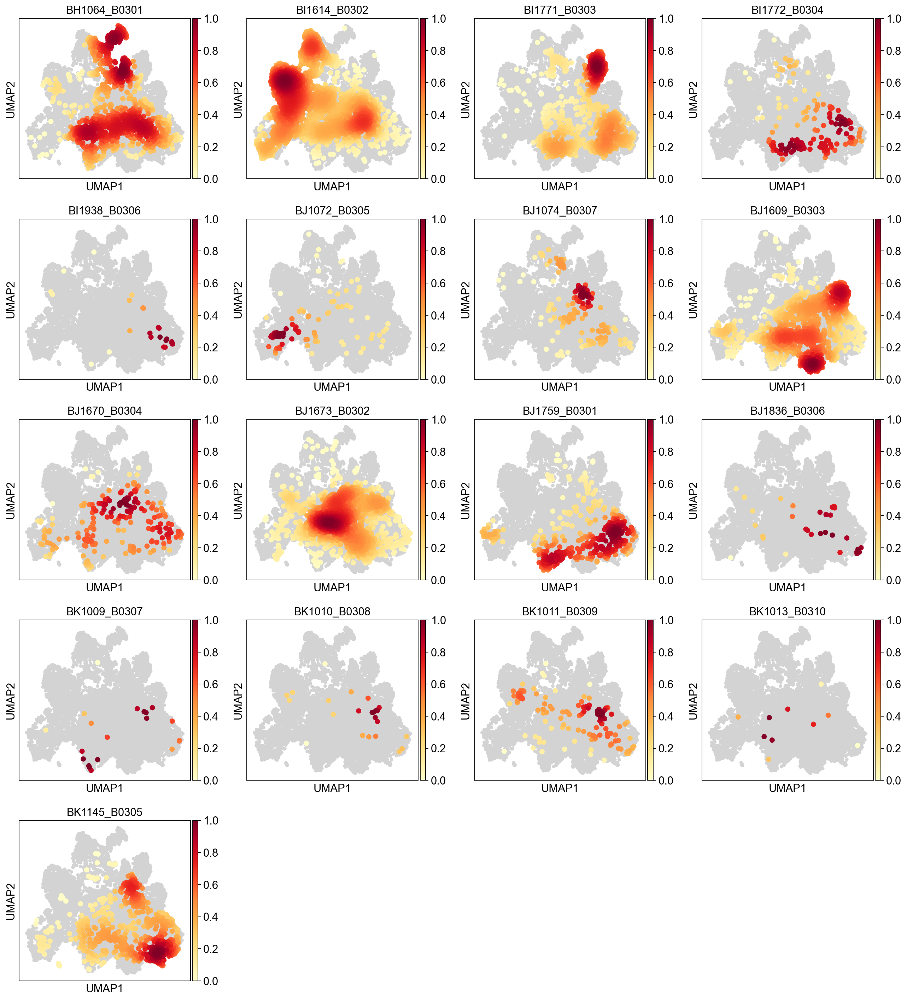

In [114]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Classification', )

## Examine differentially expressed genes

## Figures for the paper

In [115]:
adata.obs['HPCS_state'] = ['HPCS' if x == 'HPCS' else "other" for x in adata.obs['cell type']]

In [116]:
import scipy.stats
def calculateMedianStats(gene, group='HPCS_state',value='HPCS'):
    print("Gene:",gene," Group:",group)
    print("Means: In",group,np.mean(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]),
         "Out",group,np.mean(adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    print("Medians: In",group,np.median(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]),
         "Out",group,np.median(adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    print(gene,scipy.stats.mannwhitneyu(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0], 
                         adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    

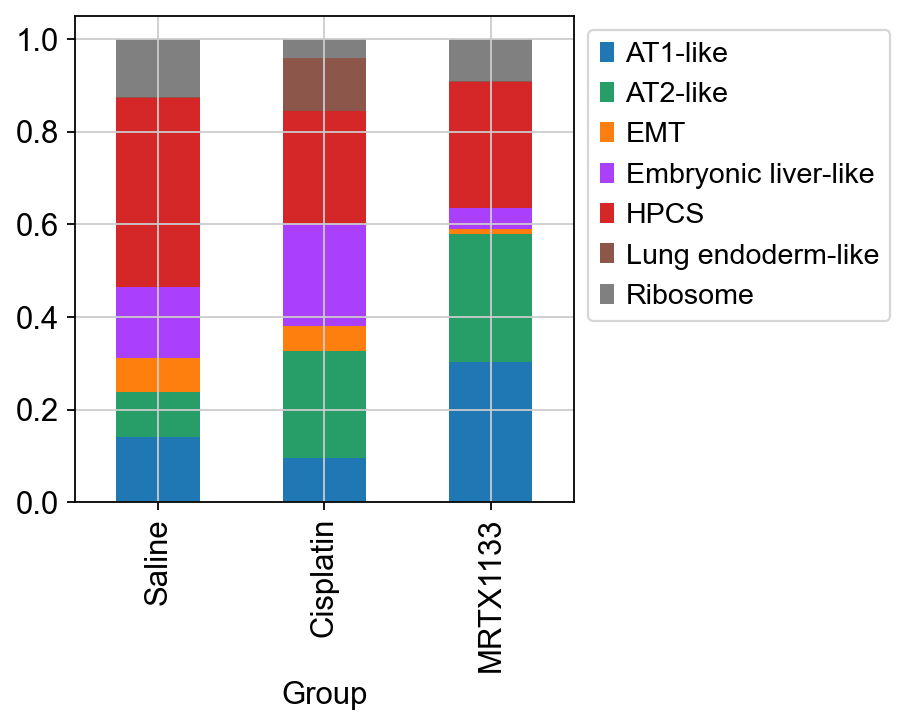

In [117]:
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True, color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Fig4d_drugproportions.svg')

## Calculate Phenotypic Volume

# Write final h5ad

In [124]:
adata.write_h5ad(results_file,compression='gzip')